### <p style="background-color:#627D50;color:#D1CABD;font-size:110%;text-align:center;border-radius:20px 60px;  border: 10px solid #cfcfcf;  padding-top: 10px;  padding-left: 10px;  padding-right: 10px; padding-bottom: 10px;  border-radius: 80px 20px;line-height: 1.2em; margin-bottom: 10px;"> **Projet 6** : Classifiez automatiquement des biens de consommation </p>

<img src="place_marche.png" align="right" alt="Alternative text" />

Vous êtes ***Data Scientist*** au sein de l'entreprise ***Place de marché***, qui souhaite lancer une marketplace e-commerce.

Sur la place de marché, des vendeurs proposent des articles à des acheteurs en postant une photo et une description.

Pour l'instant, l'attribution de la catégorie d'un article est effectuée manuellement par les vendeurs, et est donc **peu fiable**. De plus, le volume des articles est pour l'instant très petit.

Pour une meilleure expérience des vendeurs et des acheteurs, et dans l'optique d'un passage à l'échelle, ***il devient nécessaire d'automatiser cette tâche***.

*************************
- Mentor [**Babou M'BAYE**]()
- Etudiant [**Bourama FANE**](https://www.linkedin.com/in/bourama-fan%C3%A9-7aba41141/)
- Parcours [*Data Scientist*]()
- Ecole [*OpenClassrooms*](https://openclassrooms.com/fr)
- Date : [Juillet 2023]()

<!-- <style>
.right-align {
    text-align: right;
}
</style>

<ul class="right-align">
    <li>Mentor [**Babou M'BAYE**]()</li>
    <li>Etudiant [**Bourama FANE**](https://www.linkedin.com/in/bourama-fan%C3%A9-7aba41141/){:target="_blank"}</li>
    <li>Parcours [*Data Scientiste*]()</li>
</ul>
--- -->

[<font color="#337da4"> <h5> Problématique](#contexte)</h5>
[<font color="#337da4"> <h5> 1. Librairies](#1)</h5>
[<font color="#337da4"> <h5> 2. Données images ](#2)</h5>
> [2.1 Chargement & Exploration](#2.1)<br>
> [2.2 Pretraitement des images](#2.2)<br>
    
[<font color="#337da4"> <h5> 3. Features extraction](#3)</h5>
> [3.1 Algorithme SIFT-(scale-invariant feature transform)](#3.1)<br>
> [3.2 ORB (Oriented FAST and Rotated BRIEF)](#3.2)<br>
> [3.3 SURF (Speeded Up Robust Features)](#3.3)<br> 
    

### <font color="#337da4" id="contexte">Problématique </font>
----------------------------

**Contexte**
*****
L' entreprise **Place de marché souhaite** lancer une marketplace e-commerce. Pour cela, les vendeurs doivent attribuer une catégorie manuellement à leurs produits à partir d'une description et d'une photo.  Afin de passer à une plus large échelle et faciliter le processus, il devient nécessaire d'automatiser cette tâche.

**Mission**
*****
Réaliser une première **étude de faisabilité** d'un moteur de **classification d'articles** basé sur une **image et une description** pour l'**automatisation** de l'attribution de la **catégorie de l'article**.

**Objectifs**
*****
- analyser le jeu de données,
- réaliser :
    > un prétraitement des descriptions des produits<br>
    > une réduction de dimension, <br>
    > un prétraitement des images,<br>
    > puis un clustering. 

La représentation graphique aidera à convaincre que cette approche de modélisation permettra bien de regrouper des produits de même catégorie.

**Contraintes**
*****

Afin d'extraire les features texte, il sera nécessaire de mettre en oeuvre : 
- deux approches de type **bag-of-words**, comptage simple de mots et **Tf-idf** ;<br>
- une approche de type **word/sentence embedding** classique avec Word2Vec (ou Glove ou FastText) ;<br>
- une approche de type word/sentence embedding avec **BERT** ;<br>
- une approche de type word/sentence embedding avec **USE** (Universal Sentence Encoder). 

**Sources**
*****

Pour cette mission, le jeu de données est disponible [ici](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/Parcours_data_scientist/Projet+-+Textimage+DAS+V2/Dataset+projet+pre%CC%81traitement+textes+images.zip)

**Livrables :**

Afin de répondre à cette mission, trois notebook seront été réalisés : 
>  ***Notebook 1*** : Analyse des données textuelles (description) et clusterisation <br>
>  ***Notebook 2*** : Analyse des données visuelles (images) et clusterisation<br>
>  ***Notebook 3*** : Combinaison du meilleur modèle de texte et d'image et classification supervisée<br>
>  ***Presentation***: Support de presentation. 

### <font color="#337da4" id="1">1. Librairies </font>
----------------------------

In [1]:
%%time
# Built-in
import os, warnings 
from tqdm import tqdm
from tqdm.notebook import tqdm

# Data
import numpy as np
import pandas as pd
import sidetable

#Visualisation
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import missingno as msno
import seaborn as sns
from wordcloud import WordCloud
from PIL import Image
import plotly.express as px
# !pip install dataframe_to_image
import dataframe_image as dfi

# NLP
import nltk #/!\ attention use nltk.download('punkt')
from nltk.stem.snowball import EnglishStemmer
from nltk.stem import WordNetLemmatizer, PorterStemmer
from nltk.tokenize import word_tokenize, wordpunct_tokenize, RegexpTokenizer
from nltk.corpus import words, stopwords


# Cluster
from sklearn.cluster import KMeans, MiniBatchKMeans, DBSCAN
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.metrics import silhouette_score, adjusted_rand_score, silhouette_samples
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score

# metrics
from sklearn.metrics import (silhouette_samples,silhouette_score, adjusted_rand_score,
                             adjusted_mutual_info_score,confusion_matrix, pair_confusion_matrix,
                            ConfusionMatrixDisplay)

# date
from datetime import date, time, datetime, timedelta
from dateutil.relativedelta import relativedelta

# from markdown import Markdown
from IPython.display import display, Markdown
import warnings
warnings.filterwarnings("ignore")
from pandarallel import pandarallel

# Appel de mes propres functions
from function_cp import *

# Chemin
# imgPath='C:/Users/Fane0763/OpenClassroom/OC Projet 6/Graphs/'
SAVE_IMAGES = True

# Nombre aléatoire pour la reproductibilité des résultats
random_state = 42

class clr:
    start = '\033[93m'+'\033[1m'
    color = '\033[93m'
    end = '\033[0m'
    
# Affichage des valeurs
# pd.set_option('display.max_colwidth', None)

# Police et reglages
font_title = {'family': 'serif', 'color':  '#114b98', 'weight': 'bold', 'size': 16,}
font_title2 = {'family': 'serif', 'color':  '#114b98', 'weight': 'bold', 'size': 12,}
font_title3 = {'family': 'serif', 'color':  '#4F6272', 'weight': 'bold', 'size': 10,}

mycolors = ["black", "hotpink", "b", "#4CAF50"]
AllColors=['#99ff99', '#66b3ff', '#4F6272', '#B7C3F3', '#ff9999', '#ffcc99', '#ff6666', '#DD7596', '#8EB897',
           '#c2c2f0', '#DDA0DD', '#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', 
           '#7f7f7f', '#bcbd22', '#17becf', '#e41a1c', '#377eb8', '#4daf4a', '#984ea3', '#ff7f00', '#ffff33',
           '#a65628', '#f781bf', "#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7", "#000000"]

%matplotlib inline

./Flipkart/Graphs
CPU times: total: 2.52 s
Wall time: 11.3 s


In [2]:
# Variable pour définir l'environnement (local ou colab)
ENV = 'local'

# Configuration des chemins de dossiers pour les différents environnements
if ENV == 'local':
    # Développement local
    DATA_FOLDER = './Flipkart'

    
# Définition des chemins de dossiers pour l'environnement Colab
if ENV == 'colab':
    # Colaboratory - décommentez les 2 lignes suivantes pour connecter à votre drive
    # from google.colab import drive
    # drive.mount('/content/drive')
    DATA_FOLDER = '/content/drive/MyDrive/data/OC6'
    # OUT_FOLDER = '/content/drive/MyDrive/data/OC6'
    # IMAGE_FOLDER = '/content/drive/MyDrive/images/OC6/cv'

# Création d'une variable IMG_FOLDER pour le chemin complet du dossier d'images
IMG_FOLDER = os_path_join(DATA_FOLDER,'Images')
OUT_FOLDER = f'{DATA_FOLDER}/output'
IMAGE_FOLDER = f'{DATA_FOLDER}/Images'
GRAPH_FOLDER= os_path_join(DATA_FOLDER,'Graphs') # graphique pour les diapos
IMG_FOLDER_PROCESS=os_path_join(DATA_FOLDER,'Images_process') # Images traitées


SAVE_IMAGES = True
# imgPath = f'{DATA_FOLDER}/Graphs'
# if not os.path.exists(imgPath[:-1]):
#     os.makedirs(imgPath[:-1])


# Crée les dossiers spécifiés s'ils n'existent pas déjà
os_make_dir(IMAGE_FOLDER)
os_make_dir(OUT_FOLDER)
os_make_dir(GRAPH_FOLDER)  # graphique pour les diapos
os_make_dir(IMG_FOLDER_PROCESS)
imgPath=f'{GRAPH_FOLDER}/'
print(GRAPH_FOLDER)  

os.listdir(DATA_FOLDER)[:5]

./Flipkart/Graphs


['flipkart_com-ecommerce_sample_1050.csv',
 'Graphs',
 'Images',
 'Images_process',
 'output']

In [3]:
def fig_name_cleaning(fig_name: str) -> str:
    """Enlever les caractères interdits dans les filenames ou filepaths"""
    return fig_name.replace(' ', '_').replace(':', '-').replace(
        '.', '-').replace('/', '_').replace('>', 'gt.').replace('<', 'lt.')


def to_png(fig_name=None) -> None:
    """
    Register the current plot figure as an image in a file.
    Must call plt.show() or show image (by calling to_png() as last row in python cell)
    to apply the call 'bbox_inches=tight', to be sure to include the whole title / legend
    in the plot area.
    """

    def get_title() -> str:
        """find current plot title (or suptitle if more than one plot)"""
        if plt.gcf()._suptitle is None:  # noqa
            return plt.gca().get_title()
        else:
            return plt.gcf()._suptitle.get_text()  # noqa

    if SAVE_IMAGES:
        if fig_name is None:
            fig_name = get_title()
        elif len(fig_name) < 9:
            fig_name = f'{fig_name}_{get_title()}'
        fig_name = fig_name_cleaning(fig_name)
        print(f'"{fig_name}.png"')
        plt.gcf().savefig(
            # f'{IMAGE_FOLDER}/{fig_name}.png', bbox_inches='tight')
            imgPath+f'{fig_name}.png', bbox_inches='tight')


In [4]:
import psutil
psutil.cpu_count(logical=False)

4

In [5]:
# pandarallel
pandarallel.initialize(progress_bar=True,
                       nb_workers=4,
                       # verbose=1
                       )

INFO: Pandarallel will run on 4 workers.
INFO: Pandarallel will use standard multiprocessing data transfer (pipe) to transfer data between the main process and workers.

https://nalepae.github.io/pandarallel/troubleshooting/


### Version des bibliothèques

In [6]:
from platform import python_version

python_version()
print(clr.start+'Versions des bibliothèques utilisées: :.'+clr.end)
print(clr.color+'*' * 39+clr.end)
print(''.join(f'{m.__name__}=={m.__version__}''\n' for m in globals(
).values() if getattr(m, '__version__', None)))

Versions des bibliothèques utilisées: :.
***************************************
numpy==1.24.3
pandas==1.5.3
sidetable==0.9.1
missingno==0.5.2
seaborn==0.12.2
PIL.Image==9.4.0
nltk==3.7
psutil==5.9.5



#### Configuration

In [7]:
from sklearn import set_config

# pd.set_option('display.max_columns', 200)  # pour afficher toutes les colonnes
# pd.set_option('display.max_rows', 20)  # pour afficher max 10 lignes
# pd.set_option('display.max_colwidth', 100)  # pour afficher toutes la text
# pd.set_option('display.precision', 2)
pd.options.display.float_format = '{:.2f}'.format  # currency, lat,lng

# %matplotlib inline
# sns.set_theme(style="white", context="notebook")
# sns.set_color_codes("pastel")
# sns.set_palette("tab20")

set_config(display='diagram')
# displays HTML representation in a jupyter context

#### Fonctions

In [8]:
def completude(data):
    var_dict = {}
    
    for col in data.columns:
        var_dict[col] = []
        var_dict[col].append(round((data[col].notna().sum()/data.shape[0])*100,2))
        var_dict[col].append(data[col].isna().sum())
        var_dict[col].append(round(data[col].isna().mean()*100,2))
        
    return pd.DataFrame.from_dict(data=var_dict, orient="index", columns = ["Taux completion", "Nb missings","%missings"]).sort_values(by="Taux completion", ascending=False)


def namestr(obj, namespace):
    ''' fonction retourne le nom en string '''
    return [name for name in namespace if namespace[name] is obj] 

def namestr(obj, namespace):
    """
    fonction retourne le nom en string
    :param obj:
    :param namespace:
    :return:
    """
    return [name for name in namespace if namespace[name] is obj]


def get_dataframe_name(df):
    """
    Cette fonction retourne le nom du dataframe en string
    :param df: dataframe
    :return: nom du dataframe en format string
    """
    name = [x for x in globals() if globals()[x] is df][0]
    return name


def get_dataframe_name2(df):
    """
    Cette fonction retourne le nom du dataframe en string
    :param df: dataframe
    :return: nom du dataframe en format string
    """
    for x in globals():
        if globals()[x] is df:
            return x


def apercu(datasets, titles):
    """
    Cette fonction fournie les stats sur une liste de base (dataframe)
    :param titles:
    :param datasets: liste de dataframe en pandas
    :return: dataframe style
    """
    # Importations
    # import pandas as pd

    # datasets = [customers_df, geolocation_df, items_df, payments_df, reviews_df, orders_df, products_df, sellers_df,
    # category_translation_df]
    # titles=[namestr(data,globals()) for data in datasets]
    data_summary = pd.DataFrame({}, )
    data_summary['datasets'] = titles
    data_summary['columns'] = [', '.join([col for col in data.columns]) for data in datasets]
    data_summary['nb_lignes'] = [data.shape[0] for data in datasets]
    data_summary['nb_colonnes'] = [data.shape[1] for data in datasets]
    data_summary['doublons'] = [data.duplicated().sum() for data in datasets]
    data_summary['nb_NaN'] = [data.isnull().sum().sum() for data in datasets]
    data_summary['NaN_Columns'] = [', '.join([col for col, null in data.isnull().sum().items() if null > 0]) for data in
                                   datasets]
    return data_summary.style.background_gradient(cmap='YlGnBu')


def apercu2(datasets, titles):
    data_summary = pd.DataFrame({}, )
    data_summary['datasets'] = titles
    data_summary['nb_lignes'] = [data.shape[0] for data in datasets]
    data_summary['nb_colonnes'] = [data.shape[1] for data in datasets]
    data_summary['doublons'] = [data.duplicated().sum() for data in datasets]
    data_summary['nb_NaN'] = [data.isnull().sum().sum() for data in datasets]

    return data_summary.style.background_gradient(cmap='YlGnBu')


def Camembert(data,col):
    df = data[col].value_counts().reset_index()
    L=len(df[col])
    labels=list(df['index'])
    sizes=list(df[col])
    # print(labels,"\n",sizes)
    explode = Explodetuple(L)
    colors =AllColors[:L] 
    fig1, ax1 = plt.subplots(figsize=(7, 5))
    ax1.pie(sizes, explode=explode, labels=labels, colors=colors, autopct='%1.1f%%',shadow=True, startangle=0) 
    # Equal aspect ratio ensures that pie is drawn as a circle
    ax1.axis('equal')
    plt.tight_layout()
    plt.show()
    
def remplacement(data, cols, caracter1,caracter2):
    for col in cols:
        data[col] = data[col].str.lower().str.replace(caracter1, caracter2)
    return data

def remplacement2(data, cols, caracter1,caracter2):
    for col in cols:
        data[col] = data[col].str.replace(caracter1, caracter2)
    return data

def recodage(data, cols):
    for col in cols:
        data[col] = np.where((data[col].isnull()==True), "unknown", np.where(data[col] == "", "unknown", data[col]))
    return data

# Cette fonction permet de lister les modalités avec leur occurence d'unchamp qui cumule differentes modalités.
def top_words(data, cols, nb_top=100):
    count_keyword = dict()
    for index, col in data[cols].iteritems():
        if isinstance(col, float):
            continue
        for word in col.split(','):
            if word in count_keyword.keys():
                count_keyword[word] += 1
            else :
                count_keyword[word] = 1
  
    keyword_top = []
    for k,v in count_keyword.items():
        keyword_top.append([k,v])
    keyword_top.sort(key = lambda x:x[1], reverse = True)
    return keyword_top[:nb_top]


def Explodetuple(m):
    liste1=[]
    for t in range(m):
        if t in [0,1] :
            liste1.append(0.1)
        else:
            liste1.append(0)
    return tuple(liste1) 

def percentFreq(values):
    def my_format(pct):
        total = sum(values)
        val = int(round(pct*total/100.0))
        # return '{:.1f}%\n({v:d})'.format(pct, v=val)
        return '{:.1f}%({v:d})'.format(pct, v=val)
    return my_format
    

def repartitionTypeVar(data, figsize=(6, 3), 
                       title="Repartition par types de variables"):
    df = data.dtypes.value_counts()
    L = len(df)
    labels = list(df.index)
    sizes = list(df)

    explode = Explodetuple(L)
    colors = AllColors[:L] 
    fig1, ax1 = plt.subplots(figsize=figsize)
    ax1.pie(sizes, explode=explode, labels=labels, colors=colors, 
            autopct=percentFreq(df), shadow=True, startangle=0) 
    ax1.axis('equal')
    plt.tight_layout()
    plt.title(label=title, fontdict=font_title2)

    # Supprimer l'appel à plt.legend()
    plt.legend()

    #plt.show()
    return fig1, ax1
    


def fillingRate(data, grahName=''):   
    filled =data.notna().sum().sum()/(data.shape[0]*data.shape[1])
    missing =data.isna().sum().sum()/(data.shape[0]*data.shape[1])

    taux = [filled, missing]
    labels = ["%filled", "%missing"]
    
    fig, ax = plt.subplots(figsize=(5, 5))
    plt.title("Taux de completion \n", fontdict=font_title)
    ax.axis("equal")
    explode = (0.1, 0)
    ax.pie(taux, explode=explode, labels=labels, autopct='%1.2f%%', shadow=True,)
    plt.legend(labels)
    if grahName!='':
        plt.savefig(imgPath+grahName, bbox_inches='tight')  
        plt.show() 
    #plt.close()
    
import pandas as pd
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator

def nuageMots(data, col,figsize=(16,12),color="white",graphName=''):
    display(Markdown('------------------------------------'))       
    display(Markdown('#### Nuage de mots sur : {0}'.format(col)))
    display(Markdown('------------------------------------'))
    fig = plt.figure(1, figsize=figsize)
    ax1 = fig.add_subplot(1,1,1)
    #Creation de la variable text
    df=data.loc[data[col].notnull(),:]
    text = ' '.join(cat for cat in df[col])
    # Carte avec les mots: background_color="salmon"
    word_cloud = WordCloud(width=2000,height=1000,normalize_plurals=False,random_state=1,# colormap="Pastel1", 
                           collocations=False,stopwords=STOPWORDS, background_color=color, ).generate(text)
    ax1.imshow(word_cloud, interpolation="bilinear")
    # Afficher le nuage
    plt.imshow(word_cloud)
    plt.axis("off")
    if graphName!='':
        plt.savefig(imgPath+graphName, bbox_inches='tight')
    plt.show()
    plt.close()
    
def freqSimple (data, cols):
    return data[cols].unique().tolist()

def valeurUnique(data, cols):
    return data.drop_duplicates(subset=cols)[cols]


def freqSimple2(data, col_names):
    for col_name in col_names:    
        effectifs = data[col_name].value_counts()
        modalites = effectifs.index # l'index de effectifs contient les modalités
        tab = pd.DataFrame(modalites, columns = [col_name]) # création du tableau à partir des modalités
        tab["Nombre"] = effectifs.values
        tab["Frequence"] = tab["Nombre"] / len(data) # len(data) renvoie la taille de l'échantillon
        # tab = tab.sort_values(col_name) # tri des valeurs de la variable X (croissant)
        tab["Freq. cumul"] = tab["Frequence"].cumsum() # cumsum calcule la somme cumulée
        display(Markdown('------------------------------------'))       
        display(Markdown('#### Fréquence sur la variable ***' + col_name+'***'))
        display(Markdown('------------------------------------'))
        display(tab)
        

#  --------------------------------------------------------------------------
#  Graphique Count (multi-graphe) sur plusieurs variables.
#  --------------------------------------------------------------------------


def numberBycategory(data, x, axis, title, labelsize, rotation, ylabsize, saturation, palette):
    g = sns.countplot(x=x, data=data, saturation=saturation, ax=axis, palette=palette)
    for i, label1 in enumerate(axis.containers):
        axis.bar_label(label1, label_type='edge', fontsize=labelsize)
    for tick in axis.get_xticklabels():
        tick.set_rotation(rotation)
    # plt.xlabel(xtitle, color='black')

    # plt.ylabel(ytitle, color='black')
    # ax.tick_params(axis='x', colors='black')
    # g.set_xticks([])
    g.set_xlabel('')
    g.set_ylabel('Nombre', size=ylabsize)
    # ax.title.set_text(title, fontdict = {'font.size':10})
    g.set_title(title, fontdict=font_title3)
    return g


def g_multi_count(data, listvar, title, ncols=2, figsize=(12, 5), labelsize=8, rotation=0,
                  ylabsize=8, saturation=1, palette='Set3', graphName=''):
    nplot = len(listvar)
    nrows = nplot // ncols + 1
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols,  # sharey=True,  sharex=True,
                            constrained_layout=True, squeeze=False, figsize=figsize)
    axs = trim_axs(axs, nplot)
    for ax, var in zip(axs, listvar):
        numberBycategory(data, var, ax, var, labelsize, rotation, ylabsize, saturation, palette)
    fig.text(0.5, 0.90, title, ha="center", fontdict=font_title)
    if graphName != '':
        fig.savefig(imgPath + graphName, bbox_inches='tight')
    # fig.subplots_adjust(top=0.88)
    # fig.tight_layout()
    plt.show()


#  --------------------------------------------------------------------------
#  Graphique avec une aggreg function  (multi-graphe) sur plusieurs variables.
#  --------------------------------------------------------------------------


def aggBycategory(data, x, y: float, agg_func, axis, title, labelsize, rotation,
                  xlabsize, ylabsize, palette, saturation):
    dftemp = (data.groupby(x).agg({y: agg_func}).reset_index().round(0))
    g = sns.barplot(x=x, y=y, data=dftemp, saturation=saturation, ax=axis, palette=palette)
    for label1 in axis.containers:
        axis.bar_label(label1, label_type='edge', fontsize=labelsize)  # color= AllColors[i],
    for tick in axis.get_xticklabels():
        tick.set_rotation(rotation)
    # plt.xlabel(xtitle, color='black')
    # plt.ylabel(ytitle, color='black')
    axis.tick_params(axis='x', colors='black')
    axis.tick_params(axis='y', colors='black')
    for tick in axis.xaxis.get_major_ticks():
        tick.label.set_fontsize(xlabsize)

    for tick in axis.yaxis.get_major_ticks():
        tick.label.set_fontsize(ylabsize)

    # axes.legend(prop=dict(size=10))
    #    axis.yaxis.set_tick_params(labelsize=ylabsize)
    # g.set_xticks([])
    g.set_xlabel('', size=xlabsize)
    g.set_ylabel(agg_func + ' of ' + y, size=ylabsize)
    # ax.title.set_text(title, fontdict = {'font.size':10})
    g.set_title(title + "\n", fontdict=font_title3)
    return g


#  --------------------------------------------------------------------------
# muted, pastel, coolwarm,'Accent', 'cubehelix',
# 'gist_rainbow', 'terrain', 'viridis', vlag
#  --------------------------------------------------------------------------

def g_multi_agg(data, listvar, aggvar, agg_func, title, ncols=2, figsize=(12, 5), labelsize=8,
                rotation=0, xlabsize=8, ylabsize=8, palette='coolwarm', saturation=0.85, graphName='',
                shareyy: bool = True, sharexx: bool = False):
    nplot = len(listvar)
    nrows = nplot // ncols + 1
    fig, axs = plt.subplots(nrows=nrows, ncols=ncols, sharey=shareyy, sharex=sharexx,
                            constrained_layout=True, squeeze=False, figsize=figsize)
    axs = trim_axs(axs, nplot)
    for ax, var in zip(axs, listvar):
        aggBycategory(data, var, aggvar, agg_func, ax, var, labelsize,
                      rotation, xlabsize, ylabsize, palette, saturation)
    fig.text(0.5, 0.90, title, ha="center", fontdict=font_title2)
    if graphName != '':
        fig.savefig(imgPath + graphName, bbox_inches='tight')
    # fig.subplots_adjust(top=0.88)
    # fig.tight_layout()
    plt.show()


#  --------------------------------------------------------------------------
#     Function countplot de seaborn
#  --------------------------------------------------------------------------

def countplot2(data, x, title, xtitle, ytitle, figsize=(10, 3),
               labelsize=8, rotation=20, graphName: str = None, style='fast'):
    plt.style.use(style)  # 'fivethirtyeight', 'ggplot', 'bmh','seaborn-v0_8-whitegrid'
    fig = plt.figure(figsize=figsize)
    ax = sns.countplot(x=x, data=data, saturation=1)
    for i, label1 in enumerate(ax.containers):
        ax.bar_label(label1, label_type='edge', fontsize=labelsize)  # color= AllColors[i],
    for tick in ax.get_xticklabels():
        tick.set_rotation(rotation)
    plt.xlabel(xtitle, color='black')
    plt.ylabel(ytitle, color='black')
    ax.tick_params(axis='x', colors='black')
    fig.text(0.5, 0.90, title, ha="center", fontdict=font_title2)
    # plt.tight_layout()
    if graphName:
        plt.savefig(imgPath + graphName, bbox_inches='tight')
    plt.show()


#  --------------------------------------------------------------------------
#     Fonction barplot de seaborn
#  --------------------------------------------------------------------------


def barplot2(data, x, y, title, xtitle, ytitle, agg_func, figsize=(10, 3),
             labelsize=8, rotation=20, graphName: str = None, style='ggplot', palette='muted'):
    dftemp = (data.groupby(x).agg({y: agg_func}).reset_index())
    dftemp = dftemp.sort_values(by=[y], ascending=False)
    plt.style.use(style)  # 'fivethirtyeight', 'ggplot', 'bmh','seaborn-v0_8-whitegrid'
    fig = plt.figure(figsize=figsize)
    ax = sns.barplot(x=x, y=y, data=dftemp, palette=palette)  # muted, pastel,coolwarm,'Accent','cubehelix',
    # 'gist_rainbow', 'terrain', 'viridis',vlag
    for i, label1 in enumerate(ax.containers):
        ax.bar_label(label1, label_type='edge', fontsize=labelsize)  # color= AllColors[i],
    for tick in ax.get_xticklabels():
        tick.set_rotation(rotation)

    plt.xlabel(xtitle, color='black')
    plt.ylabel(ytitle, color='black')
    # plt.title(title )
    ax.tick_params(axis='x', colors='black')
    fig.text(0.5, 0.90, title, ha="center", fontdict=font_title2)
    # plt.tight_layout()
    if graphName:
        plt.savefig(imgPath + graphName, bbox_inches='tight')
    plt.show()


def barplot3(pd_df, varX, varY, agg_func, title, xrotation=0, labrotation=45,
             barlabsize=8, labcolor='m', figsize=(10, 3), graphName: str = None):
    fig = plt.figure(figsize=figsize)
    pd_df = (pd_df.groupby(varX).agg({varY: agg_func}).reset_index().round(0).sort_values(by=[varX]))
    g = sns.barplot(x=varX, y=varY, data=pd_df)
    g.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}".format(int(x))))
    g.set(xlabel=varX, ylabel=varY)
    # x labels
    g.set_xticklabels(pd_df[varX])
    for item in g.get_xticklabels():
        item.set_rotation(xrotation)
    # bar label orientation
    for i, v in enumerate(pd_df[varY].items()):
        g.text(i, v[1], "{:}".format(v[1]), color=labcolor, va='bottom',
               rotation=labrotation, size=barlabsize)

    fig.text(0.5, 0.90, title, ha="center", fontdict=font_title2)
    plt.tight_layout()
    if graphName:
        fig.savefig(imgPath + graphName, bbox_inches='tight')
    plt.show()


### <font color="#337da4" id="2">2. Données images </font>
----------------------------
<h3>Définition </h3>

La [***Computer Vision***](https://datascientest.com/computer-vision) ou ***Vision par Ordinateur*** est une **technique d'intelligence artificielle** qui consiste à analyser puis interpréter une image ou une vidéo. Au même titre que le NLP pour le texte, les méthodes de ***Computer Vision*** ont pour objectif d'interpréter des images ou des vidéos de la même manière qu'un humain. Autrement dit, elles cherchent à donner à un ordinateur la capacité de voir.

Les algorithmes de Computer Vision utilisent majoritairement des ***réseaux de neurones***, et notamment les ***CNN***.

Le terme ***Computer Vision*** regroupe tous les algorithmes qui analysent et interprètent des images ou des vidéos. Il s'agit d'un domaine à part entière en ***intelligence artificielle***, que l'on peut diviser en quatre grandes catégories :

- Classification
- Détection
- Identification
- Segmentation

<h4>Classification</h4> 

Un algorithme de classification prend en entrée une image à classer parmi une liste de possibilités. Par exemple, un algorithme qui détermine à quelle espèce appartient un animal à partir de sa photo entre dans cette catégorie.

<!-- ![](https://datascientest.com/wp-content/uploads/2020/08/image2_CV.png.webp) -->
<img src="https://datascientest.com/wp-content/uploads/2020/08/image2_CV.png.webp" align="center" width=400px />

<h4>Détection</h4>

Ici, l'objectif est de détecter sur une image la position de certains objets. Les objets « à détecter » ont été définis à l'avance, il n'est pas nécessaire d'en détecter d'autres.  La présence de ces objets est généralement représentée grossièrement par un rectangle et un nom sur l'image.
<!-- ![](https://datascientest.com/wp-content/uploads/2020/08/image_CV.png.webp) -->
<img src="https://datascientest.com/wp-content/uploads/2020/08/image_CV.png.webp" align="center" width=600px />

<h4>Identification</h4>

L'identification est utilisée pour reconnaître un objet (souvent une personne). La différence avec les algorithmes précédents est que cet algorithme est capable de faire la différence entre 2 personnes différentes. <br>
<i>C'est ce genre d'algorithme qu'utilisent Facebook, Apple ou Google Photos pour nous identifier sur nos photos.</i>

<h4>Segmentation</h4>

Ce type d'algorithme vise à délimiter les frontières entre les différents objets présents sur une image, et à classer ces derniers. Contrairement aux algorithmes de détection, ici chaque pixel appartient précisément à un unique objet.
<!-- ![](https://datascientest.com/wp-content/uploads/2020/08/1_0V2fYKOROa4nCuj3Mi3DgQ-1024x576.jpg.webp) -->
<img src="https://datascientest.com/wp-content/uploads/2020/08/1_0V2fYKOROa4nCuj3Mi3DgQ-1024x576.jpg.webp"  width=600px />

<h3>Domaines d'application de la Computer Vision </h3>

La ***Computer Vision*** est omniprésente dans la technologie d'aujourd'hui. Il est donc impensable d'en faire une liste exhaustive. De plus en plus, ce nombreux domaines et produits se basent sur la computer vision. Que ce soit le secteur automobile ou bien le secteur de la téléphonie en passant par le large secteur de la  sécurité, la computer vision nous est devenu ***indispensable*** pour ***notre développement technologique***.

> - Voitures autonomes     
> - Reconnaissance faciale     
> - Imagerie médicale      
> - Google Maps     
> - Tri des déchets     
> - etc.      

La Computer Vision est le premier pas vers une intelligence artificielle capable d’imiter le comportement humain. Lorsqu’elle est couplée à d’autres méthodes, elle peut réaliser des tâches très complexes, qui étaient jusqu’à lors réservées aux humains.


#### <font color="#337da4" id="2.1">2.1 Chargement </font>
Nous allons charger la base des images. <br>
Nous allons regarder les données dans le dataframe, puis, nous allons voir dans le dossier des images.

In [9]:
# Préparation base
dfmarket=pd.read_csv('dfcleaned.csv')
base_image = dfmarket[["image", "category1"]]

In [10]:
#comptage du nombre d'image
base_image.groupby("category1").count()

,image
category1,
Baby Care,150
Beauty and Personal Care,150
Computers,150
Home Decor & Festive Needs,150
Home Furnishing,150
Kitchen & Dining,150
Watches,150


In [11]:
# # Importation de la bibliothèque os pour gérer les opérations sur le système de fichiers
# import os

# # Variable pour définir l'environnement (local ou colab)
# ENV = 'local'

# # Configuration des chemins de dossiers pour les différents environnements
# if ENV == 'local':
#     # Développement local
#     DATA_FOLDER = './Flipkart'
#     OUT_FOLDER = './Flipkart/output'
#     IMAGE_FOLDER = './Flipkart/Images'

# # Définition des chemins de dossiers pour l'environnement Colab
# if ENV == 'colab':
#     # Colaboratory - décommentez les 2 lignes suivantes pour connecter à votre drive
#     # from google.colab import drive
#     # drive.mount('/content/drive')
#     DATA_FOLDER = '/content/drive/MyDrive/data/OC6'
#     OUT_FOLDER = '/content/drive/MyDrive/data/OC6'
#     IMAGE_FOLDER = '/content/drive/MyDrive/images/OC6/cv'

# # Création d'une variable IMG_FOLDER pour le chemin complet du dossier d'images
# IMG_FOLDER = f'{DATA_FOLDER}/Images'

# # Affiche les 5 premiers fichiers du dossier d'images
# os.listdir(IMG_FOLDER)[:5]

# # Crée les dossiers spécifiés s'ils n'existent pas déjà
# os_make_dir(IMAGE_FOLDER)

# # # Chemin complet des fichiers de données compressées et brutes
# # RAW_DATA = os_path_join(DATA_FOLDER, RAW_DATA_FILENAME)
# # DATA_ZIPPED = os_path_join(DATA_FOLDER, ZIPPED_DATA_FILENAME)
# # print(f'data file: {RAW_DATA}')


# # Les images sont stockées dans le dossier Images. Nous allons compter le nombre total d'images dans ce dossier.
# import os
# DATA_FOLDER='C:/Users/Fane0763/OpenClassroom/OC Projet 6'
# IMG_FOLDER = f'{DATA_FOLDER}/Flipkart/Images'

In [12]:
os.listdir(IMG_FOLDER)[:5]

['009099b1f6e1e8f893ec29a7023153c4.jpg',
 '0096e89cc25a8b96fb9808716406fe94.jpg',
 '00cbbc837d340fa163d11e169fbdb952.jpg',
 '00d84a518e0550612fcfcba3b02b6255.jpg',
 '00e966a5049a262cfc72e6bbf68b80e7.jpg']

In [13]:
# Compter le nombre de fichier image
LIST_PHOTOS = [file for file in os.listdir(IMG_FOLDER)]
print(len(LIST_PHOTOS))

1050


#### Repartition des images par classe

In [14]:
# --------------------------------------------------------------------
# -- PIEPLOT
# --------------------------------------------------------------------

def trace_pieplot(dataframe, variable, titre, legende, liste_colors):
    """
    Suivi des dipsersions : bosplot et qqplot
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                variable : colonne dont on veut voir les outliers (str)
                titre :titre pour les graphiques (str)
                legende : titre de la légende
                liste_colors : liste des couleurs
    @param OUT :None
    """

    plt.figure(figsize=(30, 7))
    plt.title(titre, size=16)
    nb_par_var = dataframe[variable].sort_values().value_counts()
    # nb_par_var = nb_par_var.loc[sorted(nb_par_var.index)]
    explode = [0.1]
    for i in range(len(nb_par_var) - 1):
        explode.append(0)
    wedges, texts, autotexts = plt.pie(
        nb_par_var, labels=nb_par_var.index, autopct='%1.1f%%', colors=liste_colors, textprops={
            'fontsize': 16, 'color': 'black', 'backgroundcolor': 'w'}, explode=explode)
    axes = plt.gca()
    axes.legend(
        wedges,
        nb_par_var.index,
        title=legende,
        borderaxespad=0.,
        loc=2,
        fontsize=14,
        bbox_to_anchor=(1.5, 1))
    plt.show()

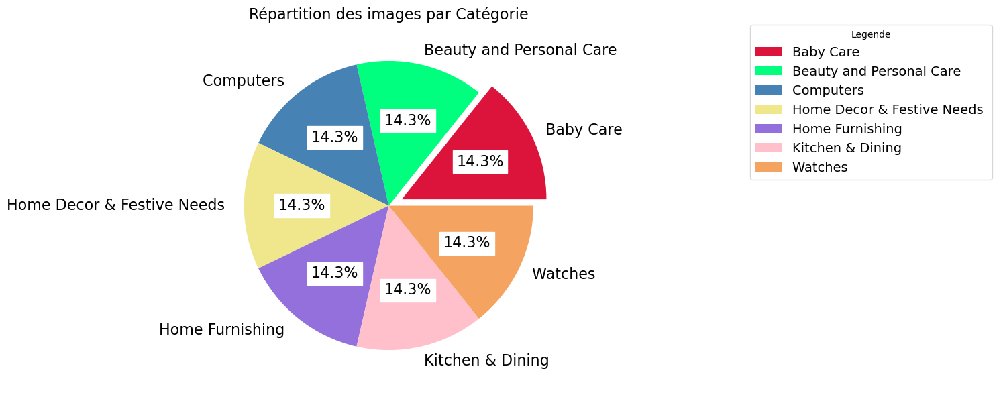

In [15]:
df_visu =base_image.groupby("category1").count().reset_index()
trace_pieplot(df_visu, 'category1',
                          'Répartition des images par Catégorie',
                          'Legende',
                          ['Crimson', 'SpringGreen', 'SteelBlue', 'Khaki',
                           'MediumPurple', 'pink', 'SandyBrown'])

#### Ajout d'un index aux images

In [16]:
# import os
# La ligne ci-dessus est commentée, ce qui signifie qu'elle est actuellement ignorée lors de l'exécution du script.
# Cela suggère que le module 'os' n'est pas utilisé dans le script, ou que son import a été effectué ailleurs dans le code.

def add_image_idx(df: pd.DataFrame, path=IMG_FOLDER):
    """Faire un lien entre l'ordre des images dans dossier

    Cette fonction prend un DataFrame 'df' en entrée et crée un lien entre l'ordre des images dans un dossier spécifié.
    
    Args:
        df (pd.DataFrame): Le DataFrame contenant les données à traiter.
        path (str): Le chemin du dossier contenant les images. Par défaut, c'est 'IMG_FOLDER'.
        
    Returns:
        pd.DataFrame: Le DataFrame 'df' mis à jour avec une colonne 'image_idx' contenant l'indice de chaque image.
    """
    
    df = df.copy()  # On effectue une copie du DataFrame pour éviter de modifier l'original.
    list_photos = [file for file in os.listdir(path)]  # Liste toutes les images dans le dossier spécifié.
    
    # Parcours des images dans le dossier pour obtenir l'indice de chaque image dans le DataFrame.
    for i, file_name in enumerate(list_photos):
        # On extrait le nom de l'image sans le chemin complet et en utilisant le séparateur approprié pour le système d'exploitation.
        image_name = ' '.join(file_name.split('/')[-1:])  # Sur les systèmes Unix (Linux, macOS).
        image_name = ' '.join(image_name.split('\\')[-1:])  # Sur les systèmes Windows.
        
        # On recherche les correspondances du nom de l'image dans la colonne 'image' du DataFrame.
        # Les correspondances sont recherchées sans tenir compte de la casse et sans utilisation d'expressions régulières.
        filtre = df['image'].str.contains(image_name, case=False, regex=False)
        
        # On attribue l'indice de l'image dans le DataFrame à la colonne 'image_idx' pour les lignes correspondantes.
        df.loc[filtre, 'image_idx'] = i
    
    df['image_idx'] = df['image_idx'].astype(int)  # On convertit la colonne 'image_idx' en type entier.
    return df  # On renvoie le DataFrame mis à jour.

dfmarket = dfmarket.pipe(add_image_idx)
dfmarket.head(3)

,product_name,image,description,cat_code,category1,clean_description,clean_description_ws,_len_description,image_idx
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,4,Home Furnishing,key feature elegance polyester multicolor abst...,key feature elegance polyester multicolor abst...,1420,342
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,0,Baby Care,specification sathiyas cotton bath towel bath ...,specification sathiyas cotton bath towel bath ...,444,505
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,0,Baby Care,key feature eurospa cotton terry face towel se...,key feature eurospa cotton terry face towel se...,1258,404


In [17]:
def image_idx(image_filename='a3dea07b2f7bf48276d32513091be717.jpg'):
    for i, filepath in enumerate(LIST_PHOTOS):
        if image_filename in filepath:
            return i
    return None


image_idx('a3dea07b2f7bf48276d32513091be717.jpg')


695

In [18]:
def get_image_from_product_name(df: pd.DataFrame = dfmarket, name='BFT 6 W LED Bulb', nb=50):
    if name is None:
        return
    products = df[df['product_name'].str.contains(
        name, case=False, regex=True)]
    if len(products) > 0:
        print(len(products))
        nb = min(nb, len(products))
        return products[['product_name', 'image']][:nb]


get_image_from_product_name(name='OTG')


4


,product_name,image
53,JRB 1038 Smallest Mobile Powered By OTG Enable...,6329ddb46087cb8c09ced95471dd9643.jpg
54,JRB 1033 Smallest Mobile Powered By OTG Enable...,7e6ae1b372e8e0b509b83ba3658b8107.jpg
55,JRB 1042 Smallest Mobile Powered By OTG Enable...,e2ae2af58ac50adf4881751ae84a9d8a.jpg
857,99Gems Smart OTG Connection kit USB USB Cable,a41371b2f8859b015031f0d5eda5184c.jpg


In [19]:
def short_name(name, maxchars=20):
    # Cette fonction renvoie une version raccourcie du nom donné si sa longueur dépasse 'maxchars'.
    # Le nom est divisé en mots, et les mots sont supprimés un par un à partir du début du nom jusqu'à ce que la longueur soit inférieure à 'maxchars'.
    while len(name) > maxchars:
        name_w = str(name).split(' ')  # Divise le nom en mots.
        name = ' '.join(str(name).split(' ')[-(len(name_w)-1):])  # Réduit le nom en enlevant le premier mot.
    return name  # Renvoie le nom raccourci.


def get_product_name_from_filename(df=dfmarket, filename='32513091be717.jpg', short=False):
    # Cette fonction renvoie le nom du produit correspondant au nom de fichier spécifié.
    # Elle recherche le nom du fichier dans la colonne 'image' du DataFrame 'df' et renvoie le nom du produit associé.

    if filename is None:
        return  # Si le nom de fichier est None, on ne peut pas continuer, donc on renvoie None.

    image_name = ' '.join(filename.split('/')[-1:])  # Obtient le nom de fichier sans le chemin complet (sur les systèmes Unix).
    image_name = ' '.join(image_name.split('\\')[-1:])  # Obtient le nom de fichier sans le chemin complet (sur les systèmes Windows).

    products = df[df['image'].str.contains(image_name, case=False, regex=False)]  # Recherche les produits correspondant au nom de fichier.

    if len(products) > 0:  # Si des produits correspondent au nom de fichier :
        name = ','.join(products['product_name'].values)  # Joindre les noms des produits correspondants en utilisant des virgules.
        return short_name(name) if short else name  # Si 'short' est True, renvoyer la version raccourcie du nom, sinon le nom complet.

get_product_name_from_filename(short=True)


'BFT 6 W LED Bulb'

#### Affichage d'une image

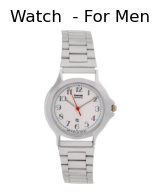

In [20]:
# from PIL import Image
# import os

def preview_image(filename=None, img=None, seed=None, ax=None, titre=None,
                  preprocess_fct=None,
                  preprocess_params={},
                  file_path=IMG_FOLDER):
    """
    Affiche une image à partir du nom de fichier ou d'un objet image donné dans un environnement Jupyter Notebook.
    
    Args:
        filename (str): Le nom du fichier de l'image à afficher. 
        img (PIL.Image.Image): L'objet image à afficher. Si 'img' est fourni, 'filename' sera ignoré.
        seed (int): index de l'image à afficher.
        ax (matplotlib.axes.Axes): L'axe matplotlib sur lequel afficher l'image. 
        titre (str): Le titre à afficher pour l'image.
        preprocess_fct (function): Une fonction de prétraitement à appliquer sur l'image avant l'affichage.
        preprocess_params (dict): Les paramètres supplémentaires pour la fonction de prétraitement. 
        file_path (str): Le chemin du dossier contenant les images. Par défaut, c'est 'IMG_FOLDER'.
    """
    
    if img is None:
        if filename is None:
            if seed is None:
                seed = np.random.randint(0, 1050)
            # seed = 352
            filename = os.listdir(file_path)[seed]

        # Charger l'image
        if file_path is None:
            img = Image.open(filename)  # Charger l'image à partir du nom de fichier donné.
        else:
            img = Image.open(f'{file_path}/{filename}')  # Charger l'image à partir du dossier spécifié avec le nom de fichier.

    if not preprocess_fct is None:
        img = preprocess_fct(img, preprocess_params)  # Appliquer la fonction de prétraitement sur l'image.

    # Afficher l'image chargée dans Jupyter Notebook
    if ax is None:
        fig = plt.figure(figsize=(2, 2))  # Créer une nouvelle figure.
        ax = plt.gca()  # Créer un nouvel axe.
    ax.imshow(img, cmap='gray')  # Afficher l'image sur l'axe avec la colormap 'gray' (niveaux de gris).
    ax.set_axis_off()  # Masquer les axes pour ne pas afficher les graduations.

    if titre is None:
        titre = get_product_name_from_filename(filename=filename, short=True)  # Obtenir le nom du produit à partir du nom de fichier.
    ax.set_title(titre)  # Définir le titre de l'image sur l'axe.

preview_image(seed=400)

#### Dimensions d'une image

In [21]:
# Récupérer et afficher la taille de l'image (en pixels)

def dim_img(seed, file_path=IMG_FOLDER):
    if isinstance(seed, int):
        seed=[seed]
    for s in seed:
        im_name = os.listdir(file_path)[s]
        print('Image :', im_name)
        img = Image.open(f'{file_path}/{im_name}')
        if type(img) == np.ndarray:
            img = Image.fromarray(img)
        m = img.mode
        w, h = img.size
        print("Largeur : {} px, hauteur : {} px, mode : {}".format(w, h,m))
        
dim_img(400)

Image : 64247967cbf6cd8bb2e243ac53aa5928.jpg
Largeur : 413 px, hauteur : 881 px, mode : RGB


#### Affichage d'un echantillon d'images

"Quelques_images_à_partir_de_l'index.png"


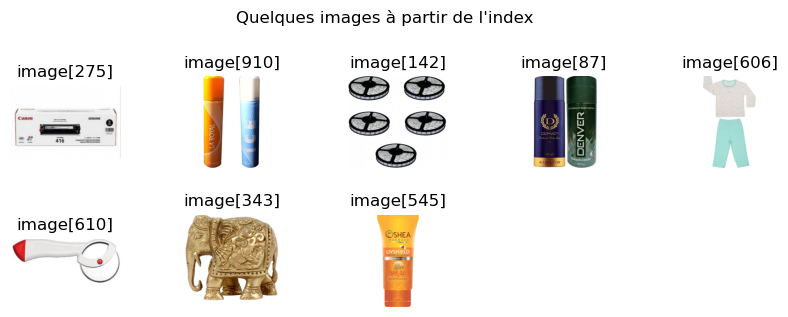

In [22]:
def preview_images(filenames, titles, titre,
                   preprocess_fct=None,
                   preprocess_params={},
                  file_path=IMG_FOLDER):
    """
    Affiche plusieurs images à partir des noms de fichiers donnés dans un environnement Jupyter Notebook.
    
    Args:
        filenames (list): Une liste de noms de fichiers d'images à afficher.
        titles (list): Une liste de titres pour chaque image. Ces titres seront affichés sous chaque image.
        titre (str): Le titre global à afficher au-dessus de toutes les images.
        preprocess_fct (function): Une fonction de prétraitement à appliquer sur chaque image avant l'affichage. Par défaut, c'est None.
        preprocess_params (dict): Les paramètres supplémentaires pour la fonction de prétraitement. Par défaut, c'est un dictionnaire vide.
    """

    # Calculer le nombre de colonnes pour l'affichage des images (maximum 5 colonnes).
    n_cols = min(5, len(filenames))
    # Calculer le nombre de lignes pour l'affichage des images en fonction du nombre de colonnes.
    n_rows = len(filenames) // n_cols + (len(filenames) % n_cols > 0)

    # Créer une nouvelle figure pour afficher les images en utilisant le nombre de colonnes et de lignes calculé.
    fig = plt.figure(figsize=(n_cols * 2, n_rows + 1))

    # Parcourir les noms de fichiers et les titres pour afficher chaque image.
    for n, filename in enumerate(filenames):
        if len(titles) > n:
            # Si un titre est fourni pour l'image, on l'utilise après l'avoir raccourci.
            image_title = short_name(' '.join(str(titles[n]).split(' ')))
        else:
            # Sinon, on utilise le nom court du produit associé au nom de fichier comme titre.
            image_title = get_product_name_from_filename(filename=filename, short=True)

        # Créer un sous-plot pour afficher l'image à la position (n + 1) dans la grille (1-indexed).
        ax = plt.subplot(n_rows, n_cols, n + 1)

        # Appeler la fonction 'preview_image' pour afficher l'image sur l'axe actuel.
        preview_image(filename, titre=image_title, ax=ax,
                      preprocess_fct=preprocess_fct, preprocess_params=preprocess_params,
                     file_path=file_path)

    # Ajuster l'espace entre les sous-plots pour améliorer la lisibilité.
    plt.subplots_adjust(hspace=0.5, wspace=0.5)

    # Ajouter le titre global au-dessus de toutes les images.
    fig.suptitle(titre, y=1.1)

    # Sauvegarder la figure en format PNG.
    to_png()

    # Afficher la figure contenant toutes les images.
    plt.show()

# seeds = seeds= np.random.randint(0, 1050,8)
seeds = [275, 910, 142, 87, 606, 610, 343, 545]

# Créer une liste de noms de fichiers d'images en fonction des index (seeds) spécifiés.
filenames = [os.listdir(IMG_FOLDER)[seed] for seed in seeds]

# Créer une liste de titres pour chaque image, en utilisant les index (seeds) spécifiés.
titles = [f'image[{seed}]' for seed in seeds]

# Appeler la fonction 'preview_images' pour afficher les images correspondant aux noms de fichiers et aux titres spécifiés.
preview_images(filenames, titles, titre='Quelques images à partir de l\'index')


#### Affichage d'images par catégories

"Home_Furnishing_.png"


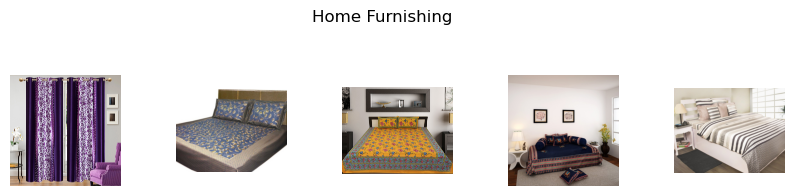

"Baby_Care_.png"


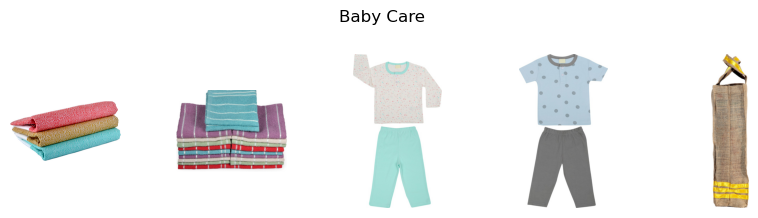

"Watches_.png"


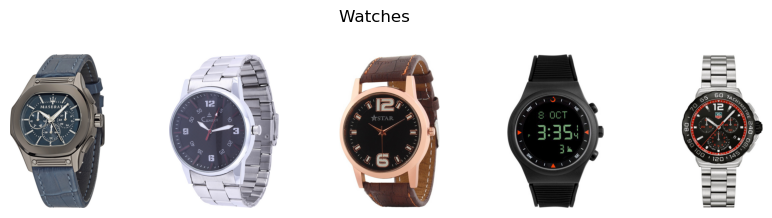

"Home_Decor_&_Festive_Needs_.png"


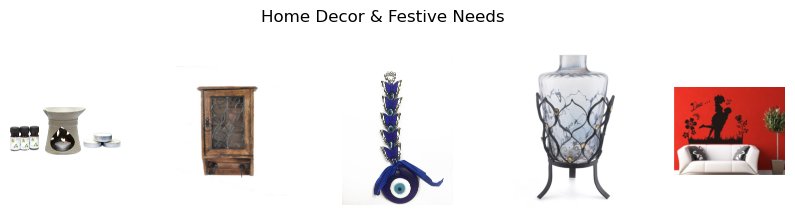

"Kitchen_&_Dining_.png"


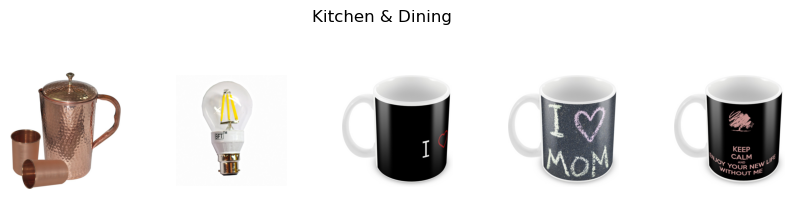

"Beauty_and_Personal_Care_.png"


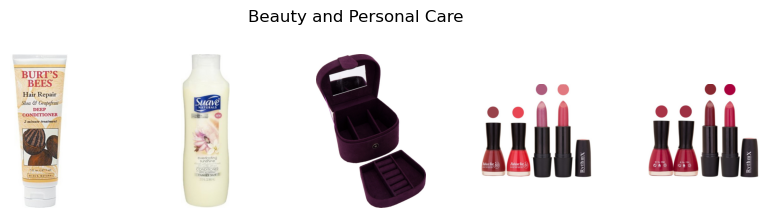

"Computers_.png"


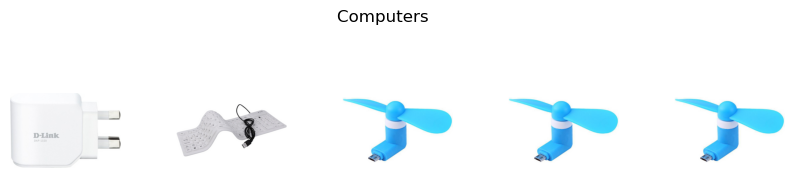

In [23]:
def preview_images_by_category(df, categ_col='category1',
                               feature='image', nb=5,
                               preprocess_fct=None,
                               preprocess_params={},
                               show_titles=False,
                               file_path=IMG_FOLDER
                               ):
    """Echantillon d'images par catégorie"""
    categories = df[categ_col].unique()
    for n, category in enumerate(categories):
        filenames = df[df[categ_col] == category][feature]
        product_names = df[df[categ_col] == category]['product_name']
        nb_im = min(nb, len(filenames))
        filenames = list(filenames[:nb_im])
        product_names = list(product_names[:nb_im]) if show_titles else ['' for i in range(nb_im)]
        preview_images(filenames, titles=product_names, titre=category,
                       preprocess_fct=preprocess_fct, preprocess_params=preprocess_params,
                       file_path=file_path)


preview_images_by_category(dfmarket, nb=5, file_path=IMG_FOLDER)


In [24]:
dfmarket['image_path'] = [os_path_join(IMAGE_FOLDER, row) for row in dfmarket['image']]
dfmarket[['image','image_path']]

,image,image_path
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,./Flipkart/Images/55b85ea15a1536d46b7190ad6fff...
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,./Flipkart/Images/7b72c92c2f6c40268628ec5f14c6...
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,./Flipkart/Images/64d5d4a258243731dc7bbb1eef49...
3,d4684dcdc759dd9cdf41504698d737d8.jpg,./Flipkart/Images/d4684dcdc759dd9cdf41504698d7...
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,./Flipkart/Images/6325b6870c54cd47be6ebfbffa62...
...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,./Flipkart/Images/958f54f4c46b53c8a0a9b8167d91...
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,./Flipkart/Images/fd6cbcc22efb6b761bd564c28928...
1047,5912e037d12774bb73a2048f35a00009.jpg,./Flipkart/Images/5912e037d12774bb73a2048f35a0...
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,./Flipkart/Images/c3edc504d1b4f0ba6224fa53a43a...


In [25]:
from PIL import Image
import pandas as pd

def get_image_properties(image_path):
    try:
        with Image.open(image_path) as img:
            width, height = img.size
            taille = len(img.tobytes())
            mode = img.mode
            depth = len(img.getbands())
        return height, width, depth, mode, taille
    except Exception as e:
        print(f"Erreur lors de la lecture de l'image {image_path}: {e}")
        return None, None, None, None

def add_image_properties(dataframe, image_name):
    dataframe[['hauteur', 'largeur', 'profondeur', 'mode','taille']] = dataframe[image_name].apply(
        lambda image_path: pd.Series(get_image_properties(image_path))
    )
    return dataframe

# Utilisez la méthode pipe pour ajouter les colonnes de hauteur, largeur, profondeur et mode
dfmarket = dfmarket.pipe(add_image_properties, image_name='image_path')

# Affichez le DataFrame mis à jour
dfmarket.head()

,product_name,image,description,cat_code,category1,clean_description,clean_description_ws,_len_description,image_idx,image_path,hauteur,largeur,profondeur,mode,taille
0,Elegance Polyester Multicolor Abstract Eyelet ...,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Key Features of Elegance Polyester Multicolor ...,4,Home Furnishing,key feature elegance polyester multicolor abst...,key feature elegance polyester multicolor abst...,1420,342,./Flipkart/Images/55b85ea15a1536d46b7190ad6fff...,3600,3600,3,RGB,38880000
1,Sathiyas Cotton Bath Towel,7b72c92c2f6c40268628ec5f14c6d590.jpg,Specifications of Sathiyas Cotton Bath Towel (...,0,Baby Care,specification sathiyas cotton bath towel bath ...,specification sathiyas cotton bath towel bath ...,444,505,./Flipkart/Images/7b72c92c2f6c40268628ec5f14c6...,1293,2388,3,RGB,9263052
2,Eurospa Cotton Terry Face Towel Set,64d5d4a258243731dc7bbb1eef49ad74.jpg,Key Features of Eurospa Cotton Terry Face Towe...,0,Baby Care,key feature eurospa cotton terry face towel se...,key feature eurospa cotton terry face towel se...,1258,404,./Flipkart/Images/64d5d4a258243731dc7bbb1eef49...,729,982,3,RGB,2147634
3,SANTOSH ROYAL FASHION Cotton Printed King size...,d4684dcdc759dd9cdf41504698d737d8.jpg,Key Features of SANTOSH ROYAL FASHION Cotton P...,4,Home Furnishing,key feature santosh royal fashion cotton print...,key feature santosh royal fashion cotton print...,858,880,./Flipkart/Images/d4684dcdc759dd9cdf41504698d7...,831,1100,3,RGB,2742300
4,Jaipur Print Cotton Floral King sized Double B...,6325b6870c54cd47be6ebfbffa620ec7.jpg,Key Features of Jaipur Print Cotton Floral Kin...,4,Home Furnishing,key feature jaipur print cotton floral king si...,key feature jaipur print cotton floral king si...,1197,391,./Flipkart/Images/6325b6870c54cd47be6ebfbffa62...,2088,2670,3,RGB,16724880


In [26]:
# import pandas as pd
# from PIL import Image  # Assurez-vous d'avoir installé le module "Pillow" pour travailler avec des images

# # La fonction pour extraire les informations d'une image
# def get_image_properties(chemin_image):
#     # Ouvrir l'image avec PIL
#     image = Image.open(chemin_image)
#     # Récupérer les dimensions de l'image
#     largeur_image, hauteur_image = image.size
#     taille_image = len(image.tobytes())
#     profondeur_image = len(image.getbands())
#     mode = image.mode
#     return largeur_image, hauteur_image, taille_image, profondeur_image, mode

# # Appliquer la fonction pour remplir les colonnes manquantes
# dfmarket[['largeur_image', 'hauteur_image', 'taille_image','profondeur_image','mode']] = \
# dfmarket['image_path'].apply(get_image_properties).apply(pd.Series)

# # Afficher le dataframe avec les nouvelles colonnes
# dfmarket[['image','cat_code','category1','largeur_image', 'hauteur_image', 'taille_image','profondeur_image','mode']]


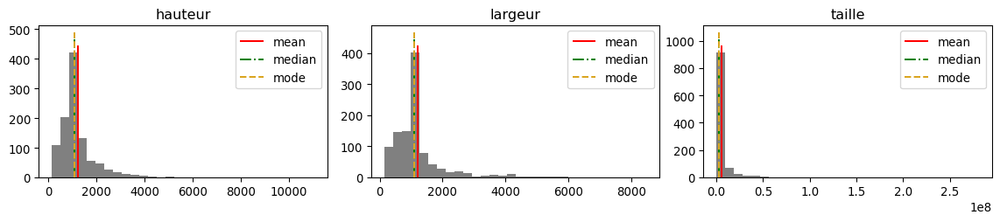

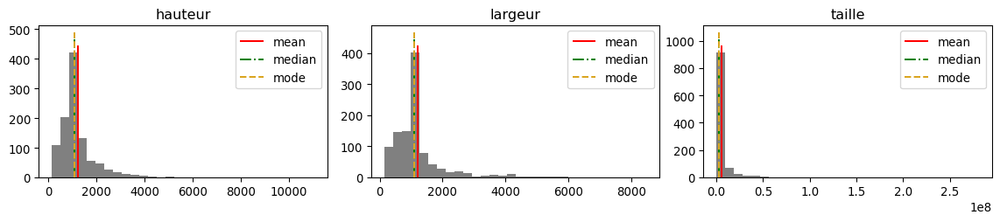

In [27]:
features=['hauteur', 'largeur', 'taille']
plot_histograms(dfmarket, features, bins=30, figsize=(12, 7), color='grey',
                    skip_outliers=False, thresh=3, layout=(3, 3), graphName=None)

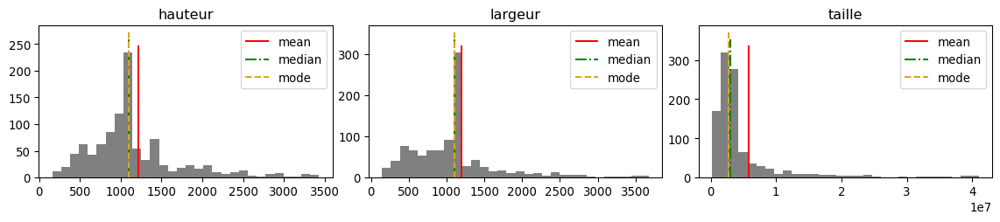

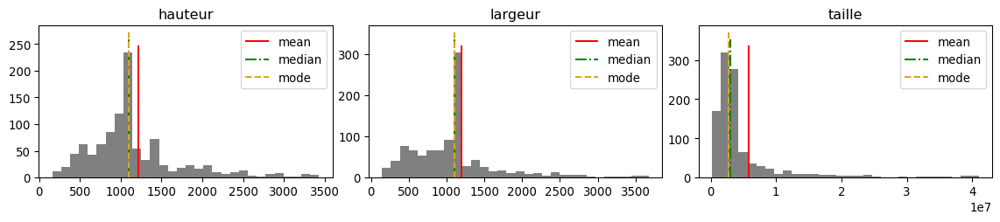

In [28]:
features=['hauteur', 'largeur', 'taille']
plot_histograms(dfmarket, features, bins=30, figsize=(12, 7), color='grey',
                    skip_outliers=True, thresh=3, layout=(3, 3), graphName=None)

In [29]:
# --------------------------------------------------------------------
# -- STATISTIQUES DESCRIPTIVES pour les var quant d'un dataframe
# --------------------------------------------------------------------


def stat_descriptives(dataframe, liste_variables):
    """
    Statistiques descriptives moyenne, mediane, variance, écart-type,
    skewness et kurtosis du dataframe transmis en paramètre
    ----------
    @param IN : dataframe : DataFrame, obligatoire
                liste_variables : colonne dont on veut voir les stat descr
    @param OUT : dataframe des statistiques descriptives
    """
    liste_mean = ['mean']
    liste_median = ['median']
    liste_var = ['var']
    liste_std = ['std']
    liste_skew = ['skew']
    liste_kurtosis = ['kurtosis']
    liste_mode = ['mode']
    liste_cols = ['Desc']
    liste_max = ['Max']
    liste_min = ['Min']

    for col in liste_variables:
        liste_mean.append(dataframe[col].mean())
        liste_median.append(dataframe[col].median())
        liste_var.append(dataframe[col].var(ddof=0))
        liste_std.append(dataframe[col].std(ddof=0))
        liste_skew.append(dataframe[col].skew())
        liste_kurtosis.append(dataframe[col].kurtosis())
        liste_cols.append(col)
        liste_mode.append(dataframe[col].mode().to_string())
        liste_min.append(dataframe[col].min())
        liste_max.append(dataframe[col].max())

    data_stats = [liste_mean, liste_median, liste_var, liste_std, liste_skew,
                  liste_kurtosis, liste_mode, liste_min, liste_max]
    df_stat = pd.DataFrame(data_stats, columns=liste_cols).round(2)


    return df_stat.style.hide_index()


stat_descriptives(dfmarket, features)

Desc,hauteur,largeur,taille
mean,1220.038095,1196.570476,5748900.640000
median,1100.000000,1100.000000,3047550.000000
var,554260.293787,745917.580271,138111755952468.015625
std,744.486597,863.665201,11752095.811066
skew,3.661225,2.845790,13.457143
kurtosis,31.760927,11.646568,289.371778
mode,0 1100,0 1100,0 2785200
Min,160,145,174000
Max,11042,8484,281040984


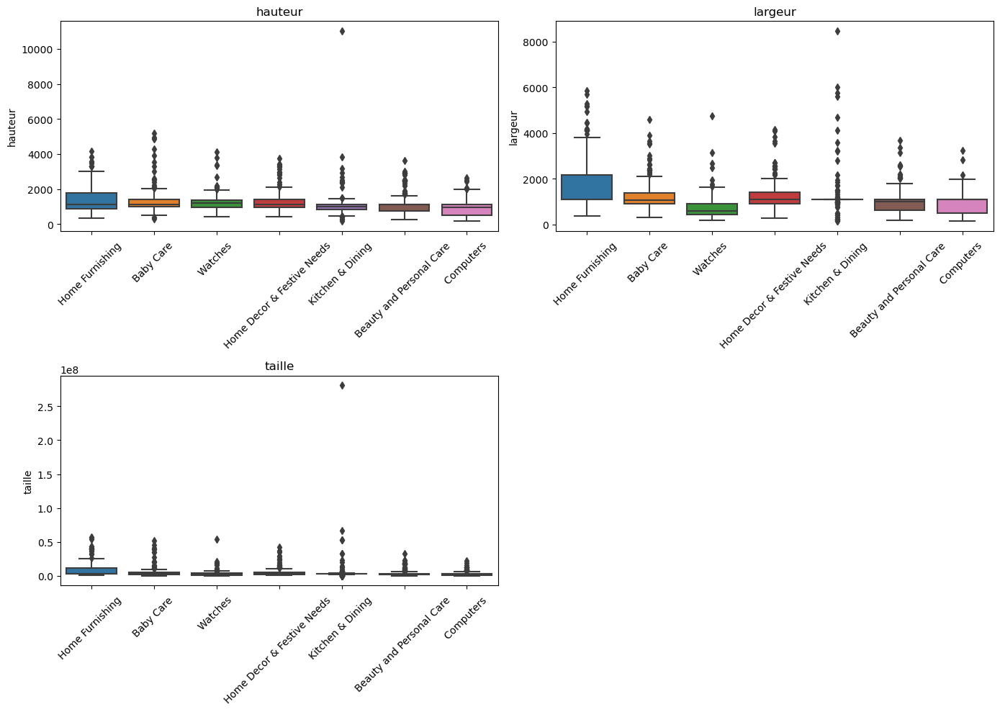

In [30]:
features=['hauteur', 'largeur', 'taille']
numeric_variables = features
nplot=len(numeric_variables)
ncols=2

def trim_axs(axs, N):
    axs = axs.flat
    for ax in axs[N:]:
        ax.remove()
    return axs[:N]

nrows = nplot // ncols + 1
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, sharey=False, sharex=False,
                        constrained_layout=True, squeeze=False, figsize=(nrows*7, ncols*5))
axs = trim_axs(axs, nplot)
for i, var in enumerate(numeric_variables):
    sns.boxplot(x='category1', y=var, data=dfmarket, ax=axs[i])
    axs[i].set_ylabel(var)
    axs[i].set_xlabel('')
    axs[i].tick_params(axis='x', rotation=45)
    axs[i].set_title(var)

plt.tight_layout()

plt.show()


In [31]:
features=['profondeur', 'mode']
# dfmarket[features].describe(include='all')
dfmarket[features].value_counts().reset_index()

,profondeur,mode,0
0,3,RGB,1050


----
Toutes les images ont le mode ***RGB*** et de profondeur ***3***.

#### <font color="#337da4" id="2.2">2.2 Pretraitement des images </font>
--------------------------------------------------------------------------------

Le prétraitement des images est une étape importante dans le traitement des données d'image. Cela implique généralement des transformations et des ajustements effectués sur les images avant leur utilisation dans des tâches spécifiques, telles que la classification, la détection d'objets, le traitement d'images médicales, etc. 

Les principales tâches de pretraitement s'articulent autour des points ci dessous. 

- Egalisation d'exposition (`PIL.ImageOps.autocontrast`)
- Egalisation de contrast (`PIL.ImageOps.equalize` )
- Filtrage de bruit (`PIL.Image.filter.GaussianBlur`)
- Filtrage de bruit (`PIL.Image.filter.MedianFilter`)
- conversion en gris (réduction de dimensions de couleur)
- reduction de taille (square, remplit)

Pour ce faire, ***Python*** propose plusieurs bibliothèques populaires pour effectuer des opérations de prétraitement d'images.

- **Pillow (PIL)** : Pillow (Python Imaging Library) est une bibliothèque de traitement d'images populaire en Python. Elle permet de lire, d'afficher, de manipuler et de sauvegarder divers formats d'images.
<img src='https://pillow.readthedocs.io/en/stable/_static/pillow-logo-dark-text.png' width='200px' align='center'>

- **OpenCV**: (Open Source Computer Vision Library) sont des librairies qui comprennent un ensemble de méthodes permettant de charger, traiter les images (redimensionnement, filtres...).
 <img src='https://www.kongakura.fr/images/opencv-5de11b6a69d84.png' width='100px' align='center'>
 
- **scikit-image :** scikit-image est une bibliothèque basée sur SciPy qui propose une large gamme de fonctionnalités de traitement d'images et de traitement d'image numérique.
 <img src='https://scikit-image.org/_static/img/logo.png' width='200px' align='center'>

#### <font color="#337da4" id="2.2.1">2.2.1 Test du processus de pretraitement images </font>

Nous allons tester dans un premier temps le processus de pretraitement sur des images choisies arbitriatrement avant de l'etendre à l'ensemble des images de la base de données. 

Comme nous avons indexé nos images, il suffira de choisir un index. Et, cette image sera utilisé pour le processus de test. 

In [32]:
seed=1048

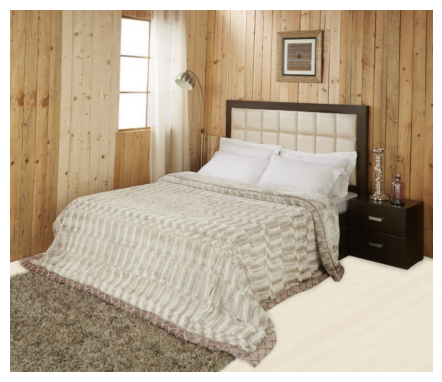

In [33]:
# import os
# import numpy as np
# from PIL import Image
# import matplotlib.pyplot as plt

def get_image(seed=None,file_path=IMG_FOLDER):
    """récupère une image et l'affiche"""
    if seed is None:
        nb_files = len(os.listdir(file_path))
        seed = np.random.randint(0, nb_files)
        print(f'get_image {seed}')
    filename = os.listdir(file_path)[seed]
    # Charger l'image
    return Image.open(f'{file_path}/{filename}')

# Appeler la fonction get_image() pour obtenir l'image
image = get_image(seed=1048) 
# Créer une fenêtre graphique avec matplotlib
plt.figure(figsize=(12, 6)) 
plt.subplot(1, 2, 1)  
plt.imshow(image)
plt.axis('off') 
plt.show()


In [34]:
def afficher_image_histopixel(image, titre):
    '''
    Afficher côte à côte l'image et l'histogramme de répartiton des pixels.
    Parameters
    ----------
    image : image à afficher, obligatoire.
    Returns
    -------
    None.
    '''
    plt.figure(figsize=(40, 10))
    plt.subplot(131)
    plt.title(titre, fontsize=30)
    plt.imshow(image, cmap='gray')
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    plt.subplot(132)
    plt.title('Histogramme de répartition des pixels', fontsize=30)
    hist, bins = np.histogram(np.array(image).flatten(), bins=256)
    plt.bar(range(len(hist[0:255])), hist[0:255])
    plt.xlabel('Niveau de gris', fontsize=30)
    plt.ylabel('Nombre de pixels', fontsize=30)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)

    plt.subplot(133)
    plt.title('Histogramme cumulé des pixels', fontsize=30)
    plt.hist(np.array(image).flatten(), bins=range(256), cumulative=True)
    plt.xlabel('Niveau de gris', fontsize=24)
    plt.ylabel('Fréquence cumulée de pixels', fontsize=30)
    plt.xticks(fontsize=30)
    plt.yticks(fontsize=30)


"Histogramme_cumulé_des_pixels.png"


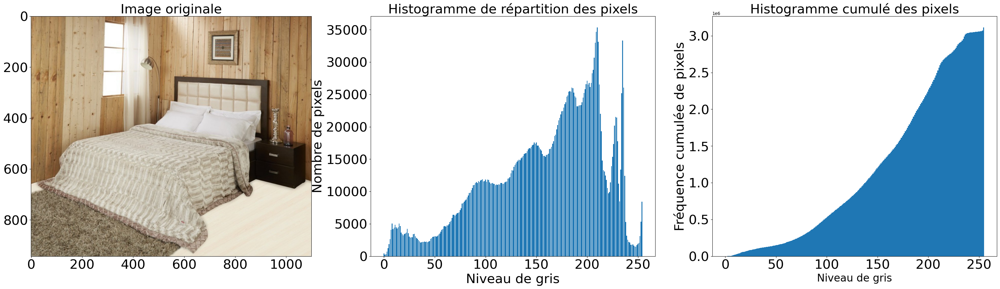

In [35]:
# Chargement de l'image originale comme matrice de pixels
img_orig =get_image(seed=seed) # Image.open('data/Images/3c4ca34c50a5437a1bcc42b72fc1351f.jpg')
afficher_image_histopixel(img_orig, 'Image originale')
to_png()

##### Egalisation d'exposition (`PIL.ImageOps.autocontrast`)
- Corriger de la luminosité (ou exposition) de l'image.
- Image sous-exposée ==> histogramme concentré à droite vers les niveaux de gris faible (255 = blanc).
- Image sur-exposée ==> histogramme concentré à gauche vers les niveaux de gris fort (0 = noir).

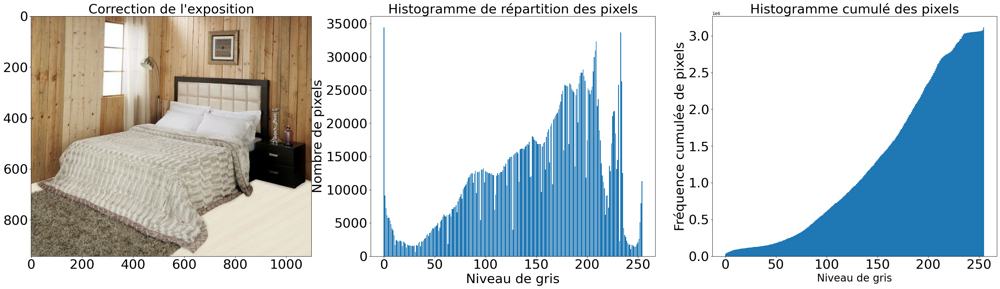

In [36]:
# Correction de l'exposition PILS
from PIL import Image, ImageOps
# from PIL.ImageOps import autocontrast
# from PIL import Image
def img_contrast(img, cutoff=1):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    img_etire = ImageOps.autocontrast(img, cutoff=cutoff)
    return img_etire

img_expo = img_contrast(img_orig, cutoff=1)
afficher_image_histopixel(img_expo, 'Correction de l\'exposition')

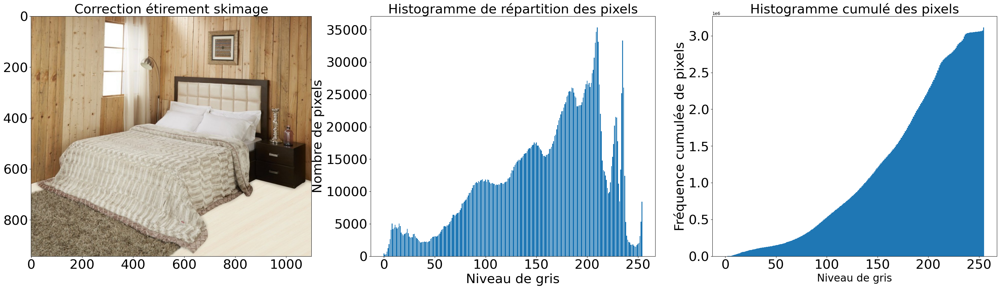

In [37]:
from skimage import io, exposure

def img_contrast_skim(img, in_range=(0, 255)):
    if type(img) != np.ndarray:
        img = np.array(img)
    img_stretched = exposure.rescale_intensity(img, in_range=in_range)
    return img_stretched

# Appliquer l'étirement d'histogramme
img_stretched = img_contrast_skim(img_orig, in_range=(0, 255))
afficher_image_histopixel(img_stretched, 'Correction étirement skimage')

##### Egalisation de contrast (`PIL.ImageOps.equalize` )
Le contraste caractérise **la répartition de lumière dans une image** : plus une image est contrastée, plus la différence de luminosité entre ses zones ***claires*** et ***sombres*** est importante. En général, une image peu contrastée est terne, tandis qu'une image trop contrastée est visuellement "**agressive**". Dans les deux cas, l'image manque de clarté car certains de ses détails seront peu, voire pas du tout,  visibles.

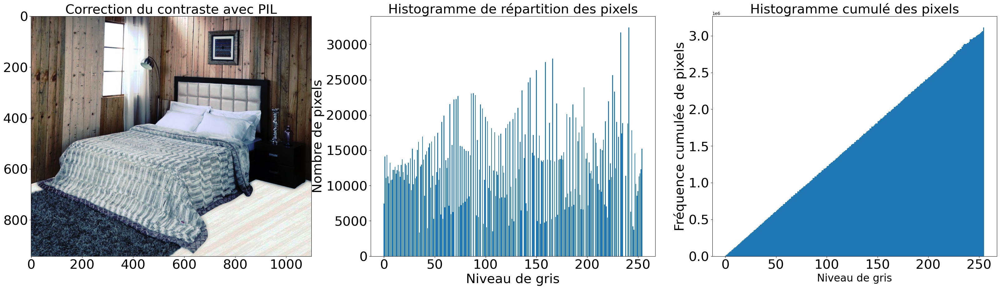

In [38]:
# from PIL.ImageOps import equalize
# from PIL import Image

def img_equalize_pil(img):
    """equalize histogram using PIL"""
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return ImageOps.equalize(img)

# Correction du contrast PIL
img_contr_pils = img_equalize_pil(img_orig) 
afficher_image_histopixel(img_contr_pils, 'Correction du contraste avec PIL')

##### Egalisation de contrast - OpenCV

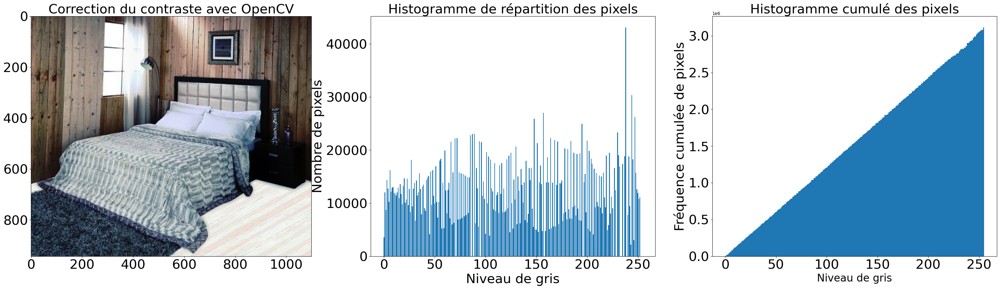

In [39]:
import cv2
def img_equalize_hist(img):
    """equalize histogram using openCV"""
    # else : # use cv2
    if type(img) != np.ndarray:
        img = np.array(img)

    if len(img.shape) == 3:
        channels = cv2.split(img)
        eq_channels = []
        for ch in channels:
            eq_channels.append(cv2.equalizeHist(ch))
        eq_image = cv2.merge(eq_channels)
        return eq_image
    else:
        return cv2.equalizeHist(img)

# Correction du contrast avec OpenCV
img_contr_opencv = img_equalize_hist(img_orig)
afficher_image_histopixel(img_contr_opencv, 'Correction du contraste avec OpenCV')

##### Egalisation de contrast OpenCV-CLAHE
Contrast Limited Adaptive Histogram Equalization (`cv2.ImageOps.equalize`)

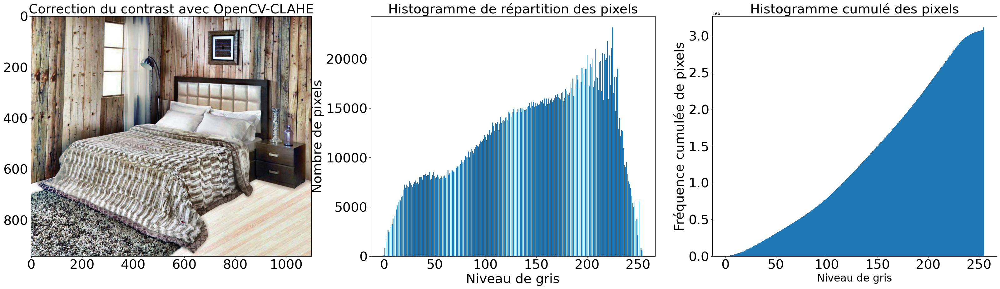

In [40]:
# import cv2
def img_equalize_clahe(img, clip_limit=4.0):
    """equalize histogram using CLAHE"""
    if type(img) != np.ndarray:
        img = np.array(img)

    clahe = cv2.createCLAHE(clipLimit=clip_limit)

    if len(img.shape) == 3:
        channels = cv2.split(img)
        eq_channels = []
        for ch in channels:
            eq_channels.append(clahe.apply(ch))
        eq_image = cv2.merge(eq_channels)
        return eq_image
    else:
        return clahe.apply(img)

# Correction du contrast avec OpenCV-CLAHE
img_contr_opencv = img_equalize_clahe(img_orig)
afficher_image_histopixel(img_contr_opencv, 'Correction du contrast avec OpenCV-CLAHE')

##### Reduction de taille (square, remplit)
Le [redimensionnement](https://medium.com/@wenrudong/what-is-opencvs-inter-area-actually-doing-282a626a09b3) d'une image en traitement d'images consiste à changer ses dimensions spatiales (largeur et hauteur) tout en conservant son contenu visuel.

Dim avant : (1100, 943)
Dim après : (224, 224)



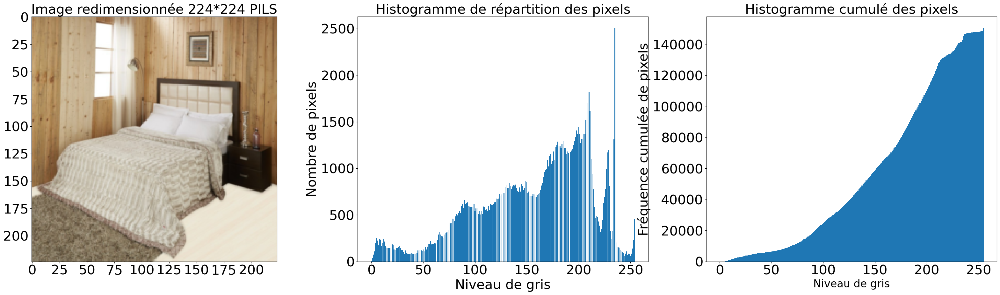

In [41]:
# Redimensionnement image PILS
# from PIL import Image

def img_resize_pil(img, sq_size=224, resample=Image.BILINEAR, displayDim=True):
    # resample = Image.LINEAR, BILINEAR, BICUBIC, ou LANCZOS
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    if displayDim:
        print('Dim avant :', (w, h))
    max_hw = max(h, w)
    scale = sq_size/max_hw
    new_w = sq_size if w >= h else int(w*scale)
    new_h = sq_size if h >= h else int(h*scale)
    if displayDim:
        print('Dim après :',(new_w, new_h))
        print()
    return img.resize((new_w, new_h), resample=resample)

img_redim_pils = img_resize_pil(img_orig)
afficher_image_histopixel(img_redim_pils,'Image redimensionnée 224*224 PILS')

Dim avant : (1100, 943)
Dim après : (224, 224)



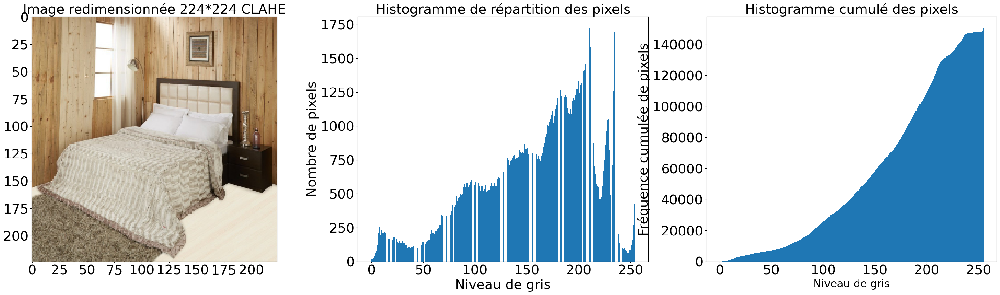

In [42]:
import cv2
# the five interpolation metode are: INTER_NEAREST, INTER_LINEAR, INTER_AREA, INTER_CUBIC, and INTER_LANCZOS4
def img_resize_opencv(img, sq_size=224, interpolation=cv2.INTER_AREA, displayDim=True): #Image.ANTIALIAS
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    if displayDim:
        print('Dim avant :', (w, h))
    max_hw = max(h, w)
    scale = sq_size/max_hw
    new_w = sq_size if w >= h else int(w*scale)
    new_h = sq_size if h >= h else int(h*scale)
    if displayDim:
        print('Dim après :',(new_w, new_h))
        print()
    return cv2.resize(np.asarray(img), (new_w, new_h), interpolation)


# Redimensionnement image contraste OpenCV 
img_redim_opencv = img_resize_opencv(img_orig)
afficher_image_histopixel(img_redim_opencv, 'Image redimensionnée 224*224 CLAHE')

##### Filtrage de bruit (`PIL.Image.filter.GaussianBlur`)
Le ***filtrage*** de bruit dans une image est une technique courante en traitement d'images qui permet de réduire le bruit indésirable et d'améliorer la qualité de l'image. Il existe plusieurs types de filtres.

- un **filtre gaussien** ,
- un **filtre par lissage par moyennage** 
- ou un **filtre par lissage médian** 
- ou un algorithme **Non-local Means Denoising (NLM)**

**Le filtre gaussien** est un filtre de lissage (ou flou) utilisé en traitement d'images pour réduire le bruit et les détails indésirables dans une image. Une *fonction gaussienne* (ou courbe en cloche)  est utilisée comme noyau de convolution pour réaliser le flou, d'ou son nom. 

Le principe du ***filtre gaussien*** est de remplacer la valeur de chaque pixel par une moyenne pondérée de ses pixels voisins, en utilisant une fenêtre gaussienne. Les pixels proches du **pixel central ont un poids plus élevé**, tandis que les **pixels plus éloignés ont un poids plus faible**, selon la distribution gaussienne.

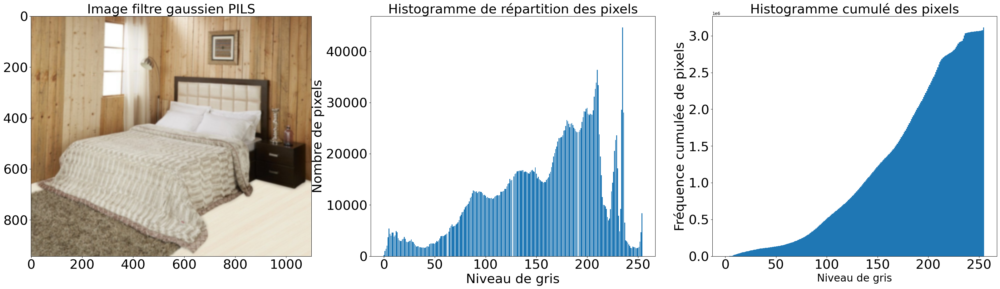

In [43]:
from PIL.ImageFilter import GaussianBlur
def img_gaussian_blur(img, radius=3):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return img.filter(GaussianBlur(radius))

# Réduction du bruit filtre gaussien sur image correction contraste PILS
img_gaus_pils = img_gaussian_blur(img_orig, radius=2)
afficher_image_histopixel(img_gaus_pils,
                              'Image filtre gaussien PILS')

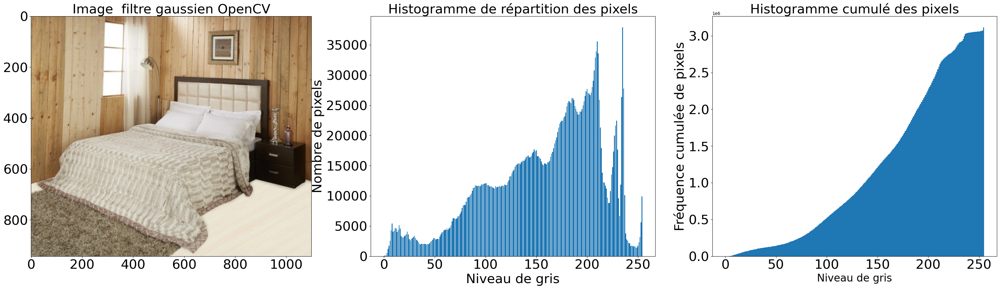

In [44]:
# Filtre gaussien  avec OpenCV
import cv2
from PIL import Image

def img_gaussian_blur_opencv(img, kernel_size=(3, 3), sigmaX=1):    
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    img_array = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    filtered_img = cv2.GaussianBlur(cv2.cvtColor(np.array(img_array), cv2.COLOR_RGB2BGR), kernel_size, sigmaX)
    return filtered_img

img_gaus_opencv = img_gaussian_blur_opencv(img_orig)
afficher_image_histopixel(img_gaus_opencv, 'Image  filtre gaussien OpenCV')

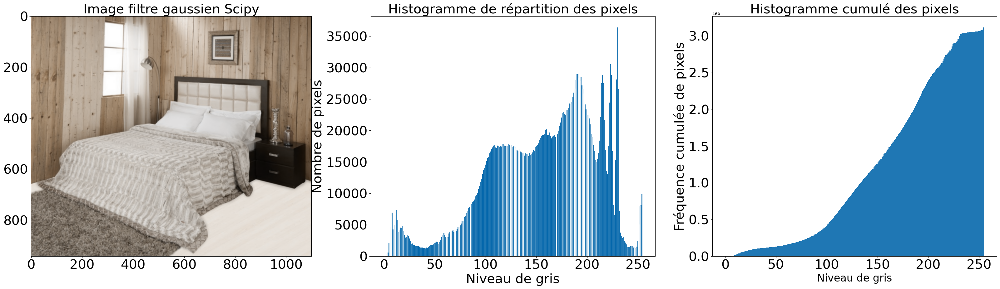

In [45]:
# Filtre gaussien avec scipy
from scipy.ndimage import gaussian_filter
img_gaus_scipy = gaussian_filter(img_orig, sigma=1)
afficher_image_histopixel(img_gaus_scipy, 'Image filtre gaussien Scipy')

##### Filtrage de bruit (`PIL.Image.filter.MedianFilter`)
Le filtre médian est un filtre non linéaire. Il remplace la valeur de chaque pixel dans l'image par la valeur médiane des pixels dans son voisinage.

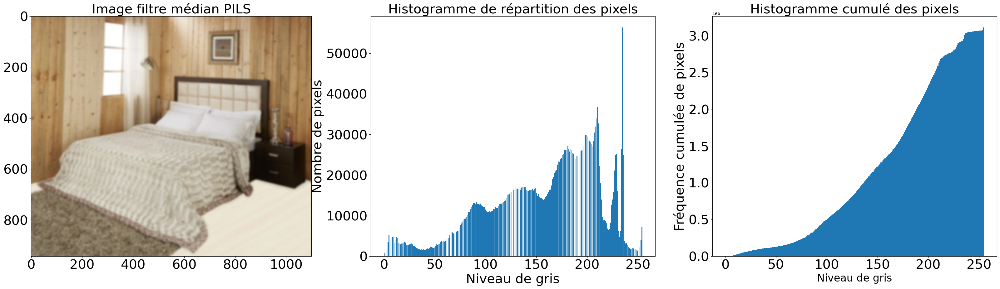

In [46]:
# from PIL import Image
# from PIL.ImageFilter import MedianFilter

def img_median_blur(img:Image or np.ndarray, size=3)->Image:
    if isinstance(img,np.ndarray):
        img = Image.fromarray(img)
    return img.filter(ImageFilter.MedianFilter(size=size))

img_median_pils = img_gaussian_blur(img_orig, radius=3)
afficher_image_histopixel(img_median_pils, 'Image filtre médian PILS')

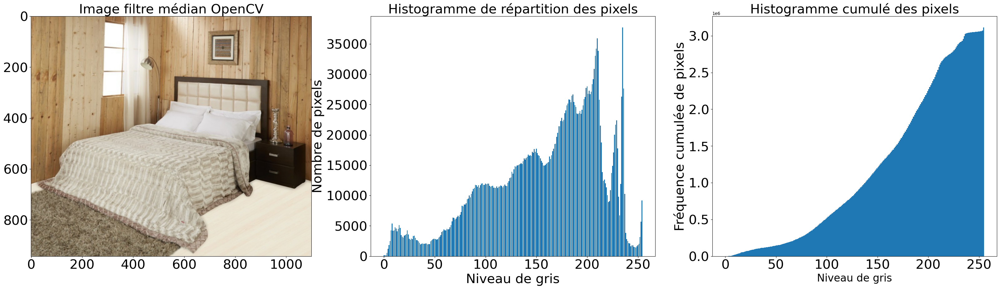

In [47]:
import cv2
from PIL import Image

def img_median_blur_opencv(img:Image or np.ndarray, kernel_size=3)->Image:
    if isinstance(img, Image.Image):
        img = np.array(img)
    return cv2.medianBlur(img, kernel_size)

img_median_opencv = img_median_blur_opencv(img_orig, kernel_size=3)
afficher_image_histopixel(img_median_opencv, 'Image filtre médian OpenCV')

##### Non-local Means Denoising d'OpenCV
L'algorithme de débruitage non local est une technique de filtrage d'images qui consiste à remplacer la valeur de chaque pixel par une moyenne pondérée des valeurs de tous les pixels similaires dans l'image.

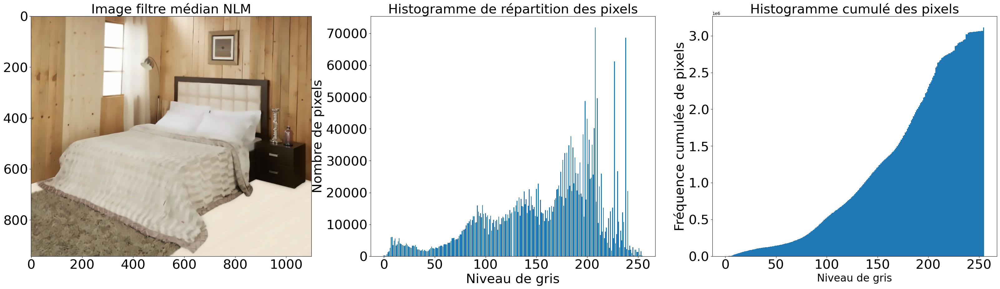

In [48]:
import cv2
import numpy as np
from PIL import Image

def img_median_blur_nlm(img: Image or np.ndarray, 
                        h=10, templateWindowSize=7, searchWindowSize=21) -> Image:
    if isinstance(img, np.ndarray):
        img = Image.fromarray(img)

    img_array = cv2.cvtColor(np.array(img), cv2.COLOR_RGB2BGR)
    img_NLM = cv2.fastNlMeansDenoisingColored(img_array, None, h=h, 
                                       templateWindowSize=templateWindowSize, 
                                       searchWindowSize=searchWindowSize)


    img_median_NLM = cv2.cvtColor(img_NLM , cv2.COLOR_BGR2RGB)
    return img_median_NLM

img_median_nlm = img_median_blur_nlm(img_orig)
afficher_image_histopixel(img_median_nlm, 'Image filtre médian NLM')


##### Conversion en gris (réduction de dimensions de couleur)
Elle consiste à transformer une image couleur (composée de trois canaux : rouge, vert et bleu) en une image en niveaux de gris (composée d'un seul canal). Cette conversion supprime les informations de couleur de l'image tout en conservant les informations de luminosité.

Une image au niveau de gris est composée de valeurs allant du blanc au noir. Le nombre de ces valeurs est dépendant du codage en bits de l’appareil : de 4 bits à 16 bits, ce qui offre des valeurs au niveau de gris de 16 à 65536 (24 à 216). Le codage le plus fréquent est celui de 8 bits, ce qui donne 256 valeurs.

Convertir une image couleur à une image au niveau de gris est souvent nécessaire pour des traitements en vision par ordinateur, tel que la détection de visage et bien d’autres opérations.

Cette conversion avec python à l’aide de la bibliothèque Pillow est possible avec la fonction convert du module Image.
Les 256 couleurs possibles prennent des valeurs de 0 à 255, où le 0 représente le noir et le 255 représente le balnc.

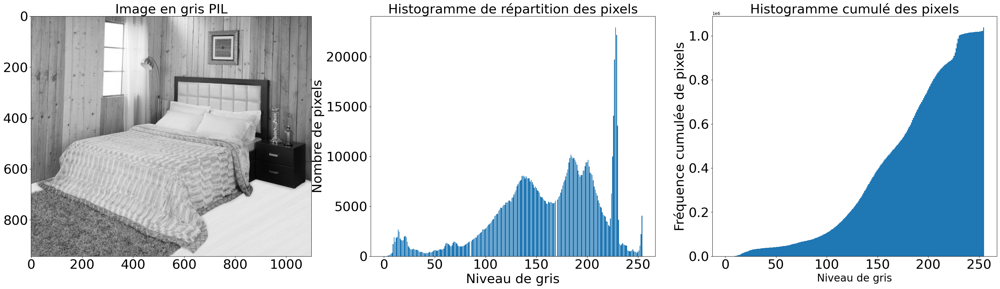

In [49]:
# from PIL import Image
# from PIL.ImageOps import grayscale
# Convertir l'image en niveaux de gris
# img_grayscale = img.convert("L") avec le format nd.array
def img_to_gray_pil(img):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return ImageOps.grayscale(img)

img_gray_pil = img_to_gray_pil(img_orig)
afficher_image_histopixel(img_gray_pil, 'Image en gris PIL')

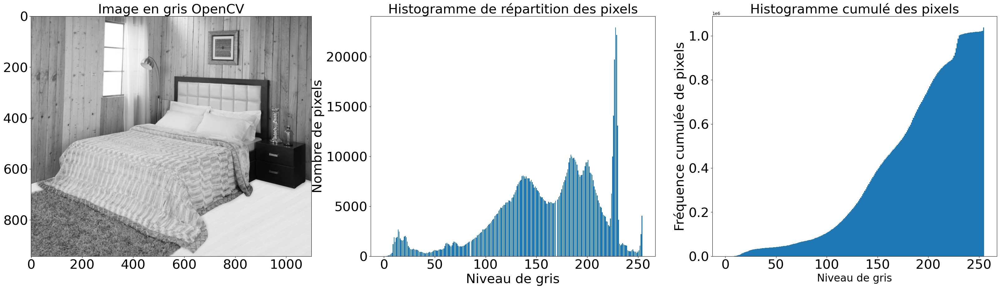

In [50]:
import cv2
# Convertir l'image en niveaux de gris OpenCV
def img_to_gray_opencv(img):
    if isinstance(img, Image.Image):
        img = np.array(img)
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

img_gray_opencv = img_to_gray_opencv(img_orig)
afficher_image_histopixel(img_gray_opencv, 'Image en gris OpenCV')

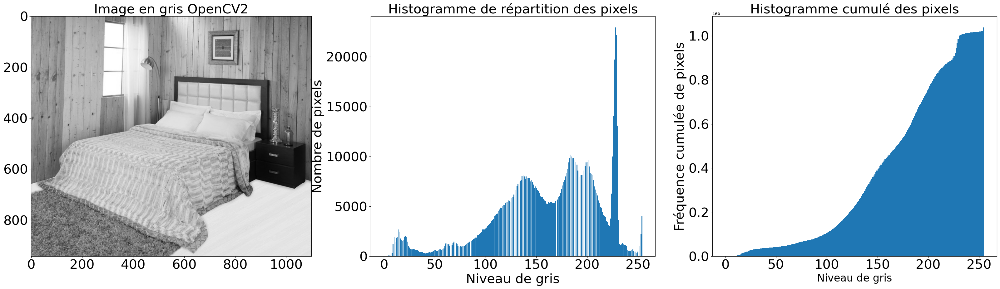

In [51]:
# Conversion de l'image en niveau de gris pour SIFT
def img_to_gray_opencv2(img):
    if isinstance(img, Image.Image):
        img = np.array(img)
    return cv2.cvtColor(np.array(img), cv2.COLOR_RGB2GRAY)

img_gray_opencv2 = img_to_gray_opencv2(img_orig)
afficher_image_histopixel(img_gray_opencv2, 'Image en gris OpenCV2')


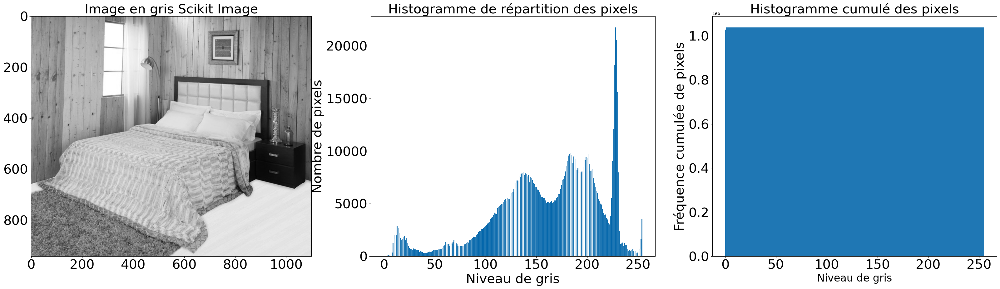

In [52]:
from skimage import io, color
# Convertir l'image en niveaux de gris
# img_grayscale = color.rgb2gray(img)


def img_to_gray_skim(img):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return color.rgb2gray(img)

img_gray_skim = img_to_gray_skim(img_orig)
afficher_image_histopixel(img_gray_skim, 'Image en gris Scikit Image')

#### <font color="#337da4" id="5.2.2">5.2.2 Processing des images </font>

In [53]:

# def os_make_dir(folder):
#     if not os.path.exists(folder):
#         os.makedirs(folder)

# # Fonction pour rejoindre un dossier et un fichier
# def os_path_join(folder, file):
#     """Remplacement pour `os.path.join(folder, file)` sur Windows"""
#     return f'{folder}/{file}'

# # Ajout variable image_loc
# # ex : data/Images/02127f52e96fb72c66bf081d25104ef8.jpg
# path = './Flipkart/Images' # IMAGE_FOLDER
# dfmarket['image_loc'] = [IMAGE_FOLDER+'/' + row for row in dfmarket['image']]
# dfmarket[['image','image_path']]
dfmarket[['image','image_path']]

,image,image_path
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,./Flipkart/Images/55b85ea15a1536d46b7190ad6fff...
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,./Flipkart/Images/7b72c92c2f6c40268628ec5f14c6...
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,./Flipkart/Images/64d5d4a258243731dc7bbb1eef49...
3,d4684dcdc759dd9cdf41504698d737d8.jpg,./Flipkart/Images/d4684dcdc759dd9cdf41504698d7...
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,./Flipkart/Images/6325b6870c54cd47be6ebfbffa62...
...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc.jpg,./Flipkart/Images/958f54f4c46b53c8a0a9b8167d91...
1046,fd6cbcc22efb6b761bd564c28928483c.jpg,./Flipkart/Images/fd6cbcc22efb6b761bd564c28928...
1047,5912e037d12774bb73a2048f35a00009.jpg,./Flipkart/Images/5912e037d12774bb73a2048f35a0...
1048,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,./Flipkart/Images/c3edc504d1b4f0ba6224fa53a43a...


In [54]:
# --------------------------------------------------------------------
# -- PRÉ-TRAITEMENT DE L'IMAGE - POUR UNE IMAGE
# --------------------------------------------------------------------

import os
import cv2
from PIL import Image

def preprocess_image(image, directory=IMG_FOLDER, newdirectory=IMG_FOLDER_PROCESS):
    """
    Pré-traite une image donnée en effectuant les étapes suivantes :

    1. Charge l'image originale.
    2. Applique la correction d'étirement pour améliorer le contraste.
    3. Convertit l'image en niveau de gris.
    4. Effectue l'égalisation d'histogramme pour corriger l'exposition.
    5. Réduit le bruit avec un filtre médian.
    6. Redimensionne l'image à une taille de 224x224 pixels.
    7. Sauvegarde l'image pré-traitée dans le répertoire spécifié.

    Args:
        image (str): Chemin d'accès à l'image à pré-traiter.
        directory (str, optional): Répertoire de sauvegarde de l'image pré-traitée. 
            Par défaut, './Flipkart/Images_process'.

    Returns:
        str: Chemin d'accès à l'image pré-traitée.
    """
    # Nom de l'image
    # file_dir = os.path.split(image)

    # Chargement de l'image originale
    #img = Image.open(image)

    # Correction d'étirement pour améliorer le contraste
    # img = img_contrast(img, cutoff=1)

    # Conversion en niveau de gris de l'image
    #img = img_to_gray_opencv2(img)

    # Correction de l'exposition avec CLAHE de OpenCV (égalisation de l'histogramme)
    #img = img_equalize_clahe(img)

    # Réduction du bruit avec le filtre médian
    #img = img_median_blur_opencv(img)

    # Redimensionnement en 224x224 pixels
    # img = img_resize_opencv(img, sq_size=224, interpolation=cv2.INTER_AREA, displayDim=False)

    
    img_gris = cv2.imread(os_path_join(directory, image),0) # passage en gris
    image_traitee = cv2.equalizeHist(img_gris)   # equalisation des histogrammes de l'image


    # Création du répertoire de sauvegarde s'il n'existe pas
    os_make_dir(newdirectory)

    # Sauvegarde de l'image dans le répertoire './Flipkart/Images_process'
    cv2.imwrite(newdirectory, image_traitee)

    return os_path_join(newdirectory, image)



In [55]:
import os
import cv2

def preprocess_image(image, directory=IMG_FOLDER, newdirectory=IMG_FOLDER_PROCESS):

    # Passage en gris et égalisation des histogrammes de l'image
    img_gris = cv2.imread(os.path.join(directory, image), cv2.IMREAD_GRAYSCALE)
    img_equalize = img_equalize_clahe(img_gris) # cv2.equalizeHist(img_gris)
    image_traitee = img_resize_opencv(img_equalize, sq_size=224, 
                                    interpolation=cv2.INTER_LINEAR, displayDim=False)

    # Création du répertoire de sauvegarde s'il n'existe pas
    os.makedirs(newdirectory, exist_ok=True)

    # Chemin complet pour sauvegarder l'image traitée
    new_image_path = os.path.join(newdirectory, image)

    # Sauvegarde de l'image dans le répertoire './Flipkart/Images_process'
    cv2.imwrite(new_image_path, image_traitee)

    return new_image_path


In [56]:
# Pré-traitement de toutes les images
print(IMG_FOLDER_PROCESS)
dfmarket['image_process'] =dfmarket['image'].apply(preprocess_image)

./Flipkart/Images_process


In [57]:
dfmarket.loc[dfmarket['image_idx']==1048,:]['image_process']

812    ./Flipkart/Images_process\ffc2e1fc7c886ec09a33...
Name: image_process, dtype: object

In [58]:
# Compter le nombre de fichier image
os.listdir(IMG_FOLDER_PROCESS)[:5]

['009099b1f6e1e8f893ec29a7023153c4.jpg',
 '0096e89cc25a8b96fb9808716406fe94.jpg',
 '00cbbc837d340fa163d11e169fbdb952.jpg',
 '00d84a518e0550612fcfcba3b02b6255.jpg',
 '00e966a5049a262cfc72e6bbf68b80e7.jpg']

1050
beaa6285a2b9c66db0e294767711ca3f.jpg


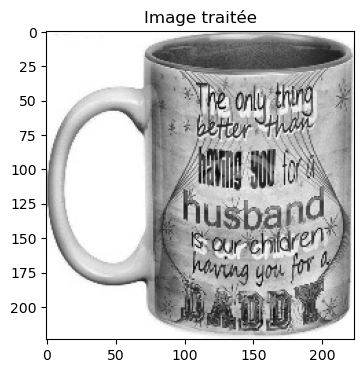

In [59]:
from PIL import Image
seed1=800

LIST_PHOTOS_PROCESS = [file for file in os.listdir(IMG_FOLDER_PROCESS)]
print(len(LIST_PHOTOS_PROCESS))
print(LIST_PHOTOS_PROCESS[seed1])

# Chargement de l'image précédemment traitéeIMG_FOLDER_PROCESS = cv2.imread(os_path_join(IMG_FOLDER_PROCESS,'3c4ca34c50a5437a1bcc42b72fc1351f.jpg'))
plt.figure(figsize=(4, 4))
plt.title('Image traitée')
#plt.imshow(os_path_join(IMG_FOLDER, "90453db0386931707b256dfa1e32c404.jpg"))
# plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
#img = Image.open(os_path_join(IMG_FOLDER_PROCESS, "90453db0386931707b256dfa1e32c404.jpg"))
image = cv2.imread(os_path_join(IMG_FOLDER_PROCESS, LIST_PHOTOS_PROCESS[seed1]),0) # convert in gray
plt.imshow(cv2.cvtColor(image,0)) # , cv2.COLOR_BGR2RGB
plt.show()

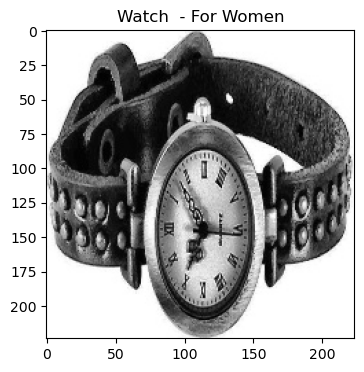

In [60]:
def display_image(seed, file_path=IMG_FOLDER_PROCESS):
    # Chargement de l'image précédemment traitée
    # mug = cv2.imread('./Flipkart/Images_process/3c4ca34c50a5437a1bcc42b72fc1351f.jpg')
    image = cv2.imread(os_path_join(file_path, os.listdir(file_path)[seed]))
    # Visualisation de l'image
    plt.figure(figsize=(4, 4))
    plt.title(get_product_name_from_filename(filename=os.listdir(file_path)[seed], short=True) )
    plt.imshow(image)
    plt.show()

display_image(seed=598, file_path=IMG_FOLDER_PROCESS)

"Home_Furnishing_.png"


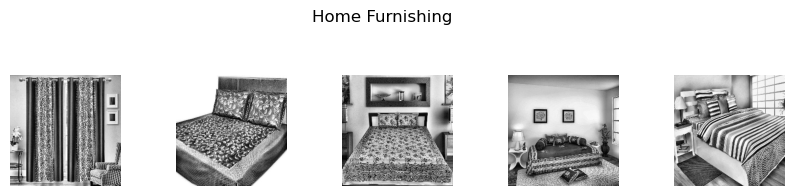

"Baby_Care_.png"


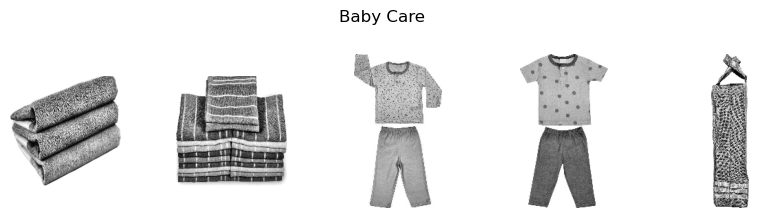

"Watches_.png"


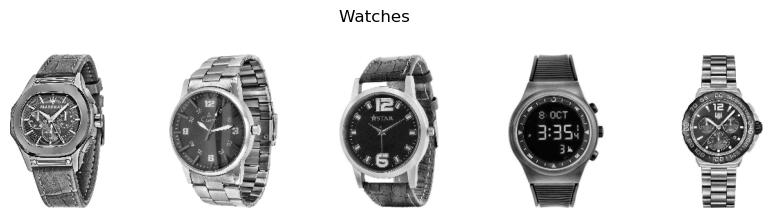

"Home_Decor_&_Festive_Needs_.png"


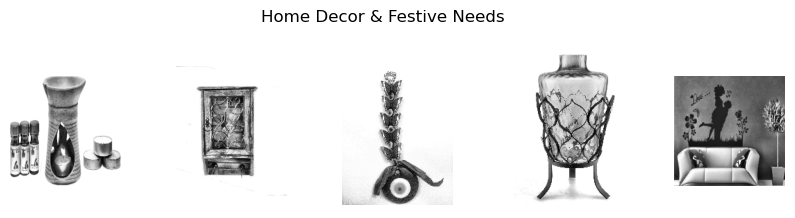

"Kitchen_&_Dining_.png"


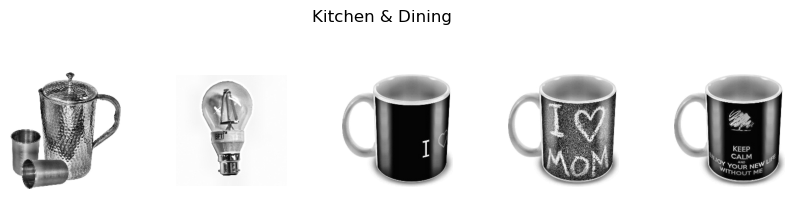

"Beauty_and_Personal_Care_.png"


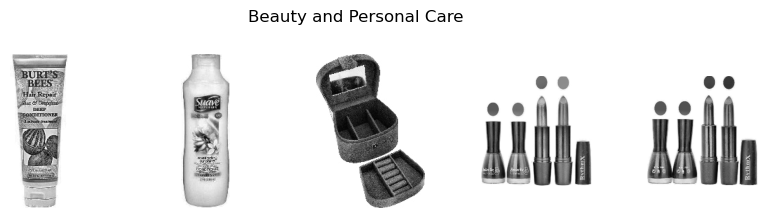

"Computers_.png"


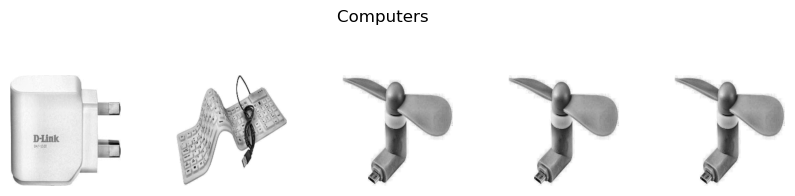

In [61]:
preview_images_by_category(dfmarket, nb=5, file_path=IMG_FOLDER_PROCESS)

In [62]:
dfmarket.columns

Index(['product_name', 'image', 'description', 'cat_code', 'category1',
       'clean_description', 'clean_description_ws', '_len_description',
       'image_idx', 'image_path', 'hauteur', 'largeur', 'profondeur', 'mode',
       'taille', 'image_process'],
      dtype='object')

### <font color="#337da4" id="3">3 Features extraction </font>

La feature extraction vise à transformer l'image brute (une matrice de pixels) en une représentation plus significative et ***exploitable*** par un algorithme de Machine Learning. Ces **caractéristiques extraites** peuvent être utilisées comme **entrée** pour des tâches de machine learning ou de deep learning.

Il existe plusieurs algo pour l'extraction de features, nous allons nous interesser aux algo ci dessous:

<ol>
<li> <b> SIFT</b>  (Scale-Invariant Feature Transform) 
<li> <b> ORB </b>(Oriented FAST and Rotated BRIEF)       
<li> <b> SURF</b> (Speeded Up Robust Features) </ol>

--------------------------------------------------------------------------------
#### <font color="#337da4" id="3.1">3.1 Algorithme SIFT-(scale-invariant feature transform) </font>

La [***scale-invariant feature transform (SIFT)***](https://fr.wikipedia.org/wiki/Scale-invariant_feature_transform), que l'on peut traduire par ***«transformation de caractéristiques visuelles invariante à l'échelle»***, est un algorithme utilisé dans le domaine de la vision par ordinateur pour détecter et identifier les éléments similaires entre différentes images numériques (éléments de paysages, objets, personnes, etc.). Il a été développé en 1999 par le chercheur ***David Lowe***.

L'étape fondamentale de la méthode proposée par Lowe consiste à calculer ce que l'on appelle les « descripteurs SIFT » des images à étudier. Il s'agit d'informations numériques dérivées de l'analyse locale d'une image et qui caractérisent le contenu visuel de cette image de la façon la plus indépendante possible de l'échelle (« zoom » et résolution du capteur), du cadrage, de l'angle d'observation et de l'exposition (luminosité).

Cet algorithme détecte des keypoints ou points d'intérêt dans l'image qui sont invariants à l'échelle et à la rotation. Il utilise des descripteurs locaux pour représenter ces keypoints, ce qui les rend très utiles pour la correspondance et la reconnaissance d'objets malgré les transformations d'échelle.

Les ***applications de la méthode sont nombreuses*** et ne cessent de s'étendre ; elles couvrent au début du $21^{e}$ siècle des domaines tels que la détection d'objet, la cartographie et la navigation, l'assemblage de photos, la modélisation 3D, la recherche d'image par le contenu, le tracking video ou le match moving.

Cet algorithme est protégé aux États-Unis par un brevet détenu par l’université de la ***Colombie-Britannique***.

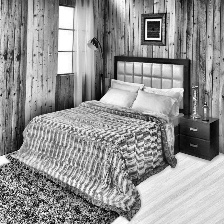

In [63]:
get_image(seed=1048,file_path=IMG_FOLDER_PROCESS)

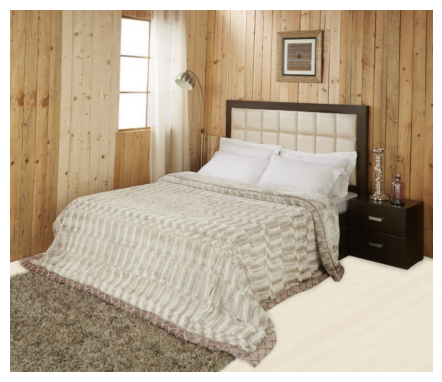

In [64]:
# import os
# import numpy as np
# from PIL import Image
# import matplotlib.pyplot as plt

def get_image(seed=None,file_path=IMG_FOLDER):
    """récupère une image et l'affiche"""
    if seed is None:
        nb_files = len(os.listdir(file_path))
        seed = np.random.randint(0, nb_files)
        print(f'get_image {seed}')
    filename = os.listdir(file_path)[seed]
    # Charger l'image
    return Image.open(f'{file_path}/{filename}')


# Appeler la fonction get_image() pour obtenir l'image
image = get_image(seed=1048,file_path=IMG_FOLDER) 
# Créer une fenêtre graphique avec matplotlib
plt.figure(figsize=(12, 6)) 
plt.subplot(1, 2, 1)  
plt.imshow(image)
plt.axis('off') 
plt.show()

Descripteurs :  (554, 128)
SIFT - Nombre de features=554 pour 128 descripteurs


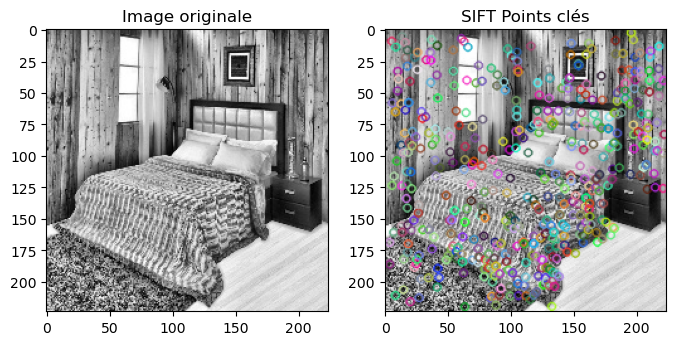

Descripteurs :  (554, 128)

[[  0.   0.  16. ...  18.  53.  15.]
 [  9.  49.  54. ...   3.   4.   8.]
 [ 18.  13.  20. ...  14.  18.   7.]
 ...
 [  9.  29. 164. ...   0.   0.   0.]
 [  0.   0.   0. ...  48.   1.  13.]
 [ 91.  33.  28. ...   1.   0.   0.]]


In [65]:
import cv2
file_path=IMG_FOLDER_PROCESS

image = cv2.imread(os_path_join(file_path, os.listdir(file_path)[seed]))
# Transformation del'image en matrice de pixels pour OpenCV
image = np.array(image)
sift=cv2.SIFT_create()
# Extraction des points d'intérêt et des descripteurs
sift_keypoints, sift_descripteurs = sift.detectAndCompute(image, None)
nb_feat = sift_descripteurs.shape[0]
nb_desc = sift_descripteurs.shape[1]
print("Descripteurs : ", sift_descripteurs.shape)
print(f'SIFT - Nombre de features={nb_feat} pour {nb_desc} descripteurs')
# Visualisation des points d'intérêt
img_sift_keyPoints = cv2.drawKeypoints(image, sift_keypoints, None)

plt.figure(figsize=(8, 4))

# Image originale
plt.subplot(1, 2, 1)
plt.title('Image originale')
plt.imshow(image)

# Image avec les points clés
plt.subplot(1, 2, 2)
plt.imshow(img_sift_keyPoints)
plt.title('SIFT Points clés')
plt.show()
print("Descripteurs : ", sift_descripteurs.shape)
print()
print(sift_descripteurs)

- L'image contient 427 descripteurs
- Chaque descripteur est un vecteur de longueur 128

### Créations des descripteurs de chaque image

- création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image
- création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisé pour créer les clusters de descripteurs

In [66]:
# image = cv2.imread(IMG_FOLDER+'/'+LIST_PHOTOS[400])
# plt.imshow(image)


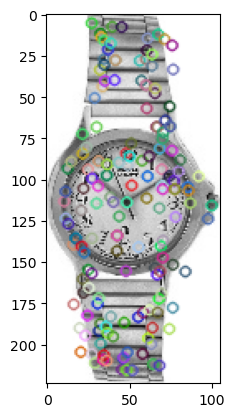

Descripteurs :  (171, 128)

[[  2.   3.   4. ...   1.   1.   7.]
 [  4.   9.  12. ...   7.   2.  13.]
 [  5.  50.  11. ...   1.   2.   3.]
 ...
 [ 90.   1.   2. ...   0.   0.   2.]
 [  5.  22.  27. ...   0.   0.   0.]
 [  0.  43. 132. ...   0.   0.   2.]]


In [67]:
import cv2

sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(IMG_FOLDER_PROCESS+'/'+LIST_PHOTOS_PROCESS[400]) 
# image = cv2.equalizeHist(image)   # equalize image histogram
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp, None)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)


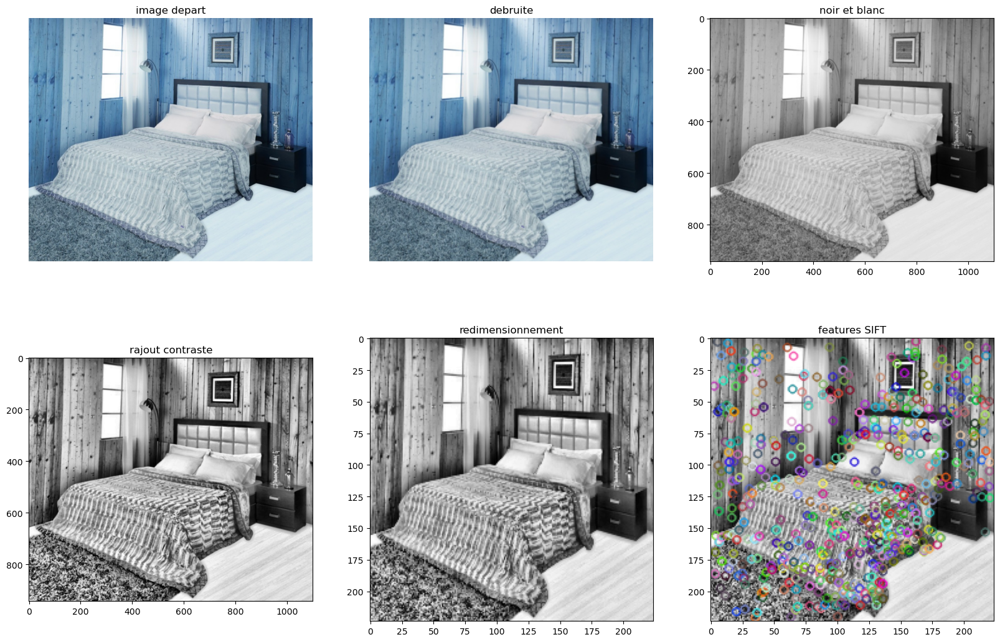

In [68]:
import cv2
import matplotlib.pyplot as plt

sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(os_path_join(IMG_FOLDER, LIST_PHOTOS[seed]))

plt.figure(figsize=(20, 13))

plt.subplot(2, 3, 1)
plt.axis('off')
plt.title('image depart')
plt.imshow(image)

# On enleve le bruit
image = cv2.GaussianBlur(image, (5, 5), 0)
plt.subplot(2, 3, 2)
plt.axis('off')
plt.title('debruite')
plt.imshow(image)

# On passe en noir et blanc (grayscale)
gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.subplot(2, 3, 3)
plt.title('noir et blanc')
plt.imshow(gray_img, cmap='gray')

# Augmentation du contraste par égalisation de l'histogramme
equalized_img = img_equalize_clahe(gray_img) # cv2.equalizeHist(gray_img)
plt.subplot(2, 3, 4)
plt.title('rajout contraste')
plt.imshow(equalized_img, cmap='gray')

# On redimensionne pour normaliser l'entrée
dsize = (224, 224)
resized_img = cv2.resize(equalized_img, dsize)
plt.subplot(2, 3, 5)
plt.title('redimensionnement')
plt.imshow(resized_img, cmap='gray')

# Detection des features ORB
kp, des = sift.detectAndCompute(resized_img, None)
img = cv2.drawKeypoints(resized_img, kp, resized_img)
plt.subplot(2, 3, 6)
plt.title('features SIFT')
plt.imshow(img)
plt.savefig('fig_trait_sift.jpg')
plt.show()


In [69]:
# import time, cv2
# import numpy as np

# data = dfmarket
# # data=data.loc[~(data.image=='5518124b75d6c6dfee4c2e4c0cfa716a.jpg'),:]
# path = IMG_FOLDER_PROCESS + '/'

# # Identification des points clés et des descripteurs associés
# sift_keypoints = []
# index_without_descriptors=[]
# temps1 = time.time()
# sift = cv2.xfeatures2d.SIFT_create(500)

# for image_num in range(len(data["image"])):
#     if image_num % 100 == 0:
#         print(image_num)
#     # image = np.array(Image.open(path + data.image[image_num]))
#     image = cv2.imread(path + data.image[image_num])
#     # res = cv2.equalizeHist(image)
#     try:
#         kp, des = sift.detectAndCompute(image, None)
#         if des is not None:  # Check if keypoints and descriptors were found
#             sift_keypoints.append(des)
#         else:
#             index_without_descriptors.append(image_num)
#     except:
#         print(image_num)
#         print(path+ data.image[image_num])
#         # image.show(path + data.image[image_num])
#         plt.imshow(image)
        

# sift_keypoints_by_img = np.asarray(sift_keypoints)
# sift_keypoints_all =np.concatenate(sift_keypoints_by_img, axis=0)

# print()
# print("Nombre de descripteurs : ", sift_keypoints_all.shape)
# duration1 = time.time() - temps1
# print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")    

In [70]:
import time, cv2
import numpy as np

data = dfmarket
# data=data.loc[~(data.image=='5518124b75d6c6dfee4c2e4c0cfa716a.jpg'),:]
path = IMG_FOLDER_PROCESS + '/'

# Identification des points clés et des descripteurs associés
sift_keypoints = []
index_without_descriptors = []
temps1 = time.time()
sift = cv2.xfeatures2d.SIFT_create()

for index, row in data.iterrows():  # Use 'iterrows()' to iterate through the rows of the DataFrame
    if index % 100 == 0:
        print(index)
    # image = np.array(Image.open(path + row['image']))
    image = cv2.imread(path + row['image'])
    # res = cv2.equalizeHist(image)
    try:
        kp, des = sift.detectAndCompute(image, None)
        if des is None:  # Check if keypoints and descriptors were found
            des = [np.zeros((128,))]
        sift_keypoints.append(des)
    except:
        print('index :', index, 'path :', path + row['image'])
        index_without_descriptors.append(index)
        # image.show(path + row['image'])
        plt.imshow(image)

sift_keypoints_by_img = np.asarray(sift_keypoints, dtype=object)
sift_keypoints_all = np.concatenate(sift_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)
duration1 = time.time() - temps1
print("temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (320551, 128)
temps de traitement SIFT descriptor :            23.19 secondes


#### Création des clusters de descripteurs

- Utilisation de MiniBatchKMeans pour obtenir des temps de traitement raisonnables

In [71]:
from sklearn import cluster, metrics

# Determination number of clusters
temps1=time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init='k-means++', init_size=3*k, random_state=random_state)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  566
Création de 566 clusters de descripteurs ...
temps de traitement kmeans :             4.86 secondes


#### Création des features des images
* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image
   
Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster

In [72]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :            23.20 secondes


In [73]:
kmeans

MiniBatchKMeans(init_size=1698, n_clusters=566, random_state=42)

## Réductions de dimension

### Réduction de dimension PCA
* La réduction PCA permet de créer des features décorrélées entre elles, et de diminuer leur dimension, tout en gardant un niveau de variance expliquée élevé (99%)
* L'impact est une meilleure séparation des données via le T-SNE et une réduction du temps de traitement du T-SNE

In [74]:
# from sklearn import manifold, decomposition
feat_pca, c = pca_data(im_features, scaler=StandardScaler(), n_comp=0.99)

Shape avant réduction :  (1050, 566)

Shape après réduction : (1050, 496)
Il faut 496 composantes pour expliquer 99% de la variance du dataset.



************************************************************************************************************************
Reduction : PCA, ARI :  0.0501, time : 1.0
************************************************************************************************************************



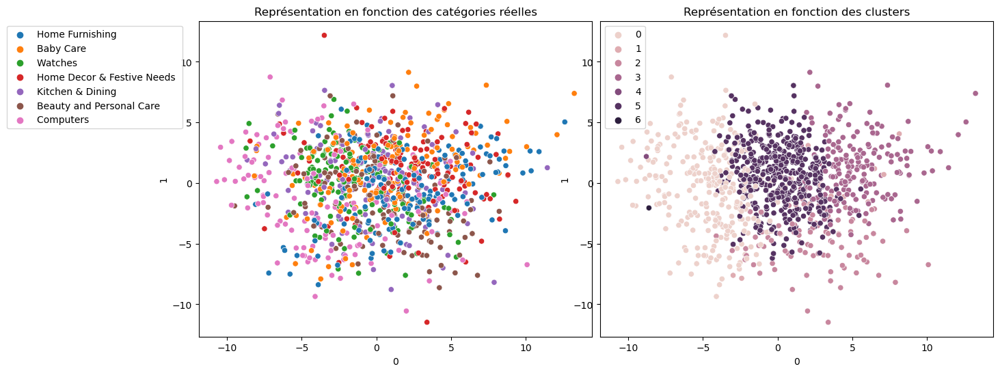

In [75]:
y_true=dfmarket['category1']
y_pred, ARI = visu_categories(feat_pca, y_true, reduction='PCA', figsize=(15, 6))

### Réduction de dimension T-SNE
* Réduction de dimension en 2 composantes T-SNE pour affichage en 2D des images
* Analyse visuelle : affichage T-SNE selon catégories d'images et les clusters

************************************************************************************************************************
Reduction : TSNE, ARI :  0.0277, time : 6.0
************************************************************************************************************************



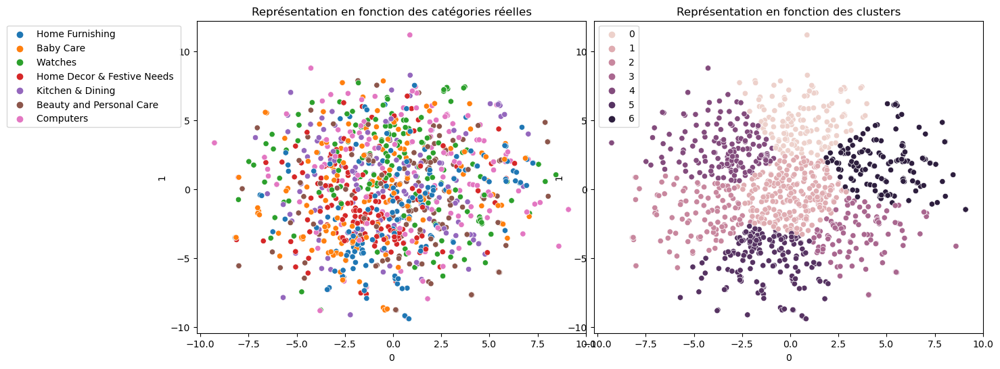

In [76]:
y_pred, ARI = visu_categories(feat_pca, y_true, reduction='TSNE', figsize=(15, 6))

[[33  2  3 44  0 68  0]
 [27  0 36 13  0 74  0]
 [99  6 13  8  1 22  1]
 [15  2  4 45  0 84  0]
 [21  6  4 51  0 68  0]
 [39  1 12 22  0 76  0]
 [59  0 21  5  0 65  0]]
**************************************************
Correspondance calculée : [2 2 1 4 2 3 2]
Correspondance          : [2, 4, 1, 5, 6, 3, 0]

**************************************************
[[ 0  3 33 68  2 44  0]
 [ 0 36 27 74  0 13  0]
 [ 1 13 99 22  6  8  1]
 [ 0  4 15 84  2 45  0]
 [ 0  4 21 68  6 51  0]
 [ 0 12 39 76  1 22  0]
 [ 0 21 59 65  0  5  0]]
**************************************************
Métriques de performance par classe:.
**************************************************

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       150
           1       0.39      0.24      0.30       150
           2       0.34      0.66      0.45       150
           3       0.18      0.56      0.28       150
           4       0.35      0.04      0.07       150
   

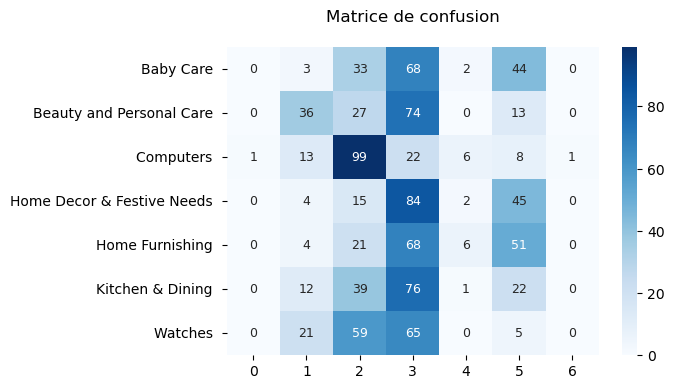

In [77]:
corresp=[2, 4, 1, 5, 6, 3, 0]
matrice_confusion(dfmarket,'category1',"cat_code", feat_pca, corresp=corresp)
to_png(fig_name='confusion_sift')

In [80]:
# Ressources utilisées pour cette partie:
# https://nextjournal.com/ml4a/image-t-sne
# Notebooks:  Mark Creasey
# https://www.kaggle.com/code/gaborvecsei/plants-t-sne/notebook
# from sklearn import manifold
# import time


def tsne_data(features: pd.Series) -> np.ndarray:
    """
    reduction de dimensions par t-SNE
    Parameters
    ---------
    features  numpy array, pd.Series or pd.DataFrame of shape[m,n]

    Returns
    ---------
    numpy array of shape[m,2]
    """
    print(f'reducer t-SNE, input shape={features.shape}')
    time1 = time.time()
    tsne_model = TSNE(n_components=2, perplexity=30, n_iter=2000,
                               init='random', learning_rate=200, random_state=random_state)
    X_tsne = tsne_model.fit_transform(features)
    time2 = np.round(time.time() - time1, 0)
    print(f'reducer t-SNE, shape ={X_tsne.shape} time : {time2}')
    return X_tsne



def img_resize(img, sq_size=224, interpolation=Image.ANTIALIAS):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    max_hw = max(h, w)
    scale = sq_size/max_hw
    new_w = sq_size if w >= h else int(w*scale)
    new_h = sq_size if h >= h else int(h*scale)
    return cv2.resize(np.asarray(img), (new_w, new_h), interpolation)

# from PIL import Image
import random

def affiche_images_tsne(X_2d_data, filelist, figsize=(20, 20), sample_size=1000, filepath=IMG_FOLDER):
    """visualise images sur t-SNE
    Parameters
    ----------
    X_2d_data np.array or pd.DataFrame of shape [m, n>=2]
    filelist   list of filenames in filepath, or full path to file if filepath is None
    """
    if len(filelist) > sample_size:
        sort_order = sorted(random.sample(range(len(filelist)), sample_size))
        filelist = [filelist[i] for i in sort_order]
        X_2d_data = X_2d_data[sort_order]

    tx, ty = X_2d_data[:, 0], X_2d_data[:, 1]
    tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
    # 0 is top, so invert ty position for same form as a scatterplot
    ty = (np.max(ty)-ty) / (np.max(ty) - np.min(ty))

    width = 2000
    height = 1500
    max_dim = 100

    # Disable DecompressionBombWarning:
    # Image size (93680328 pixels) exceeds limit of 89478485 pixels
    max_pixels = Image.MAX_IMAGE_PIXELS
    Image.MAX_IMAGE_PIXELS = 93680328+1
    full_image = Image.new('RGBA', (width, height))
    for filename, x, y in zip(filelist, tx, ty):
        if filepath is None:
            tile = Image.open(filename)
        else:
            tile = Image.open(f'{filepath}/{filename}')
        tile = Image.fromarray(img_resize(tile))
        # tile = Image.fromarray(img)
        rs = max(1, tile.width/max_dim, tile.height/max_dim)
        tile = tile.resize(
            (int(tile.width/rs), int(tile.height/rs)), Image.ANTIALIAS)
        full_image.paste(tile, (int((width-max_dim)*x),
                         int((height-max_dim)*y)), mask=tile.convert('RGBA'))

    Image.MAX_IMAGE_PIXELS = max_pixels
    plt.figure(figsize=figsize)
    plt.imshow(full_image)

reducer t-SNE, input shape=(1050, 496)
reducer t-SNE, shape =(1050, 2) time : 12.0
"Visualisation_des_produits_sur_TSNE_sur_la_base_des_features_SIFT.png"


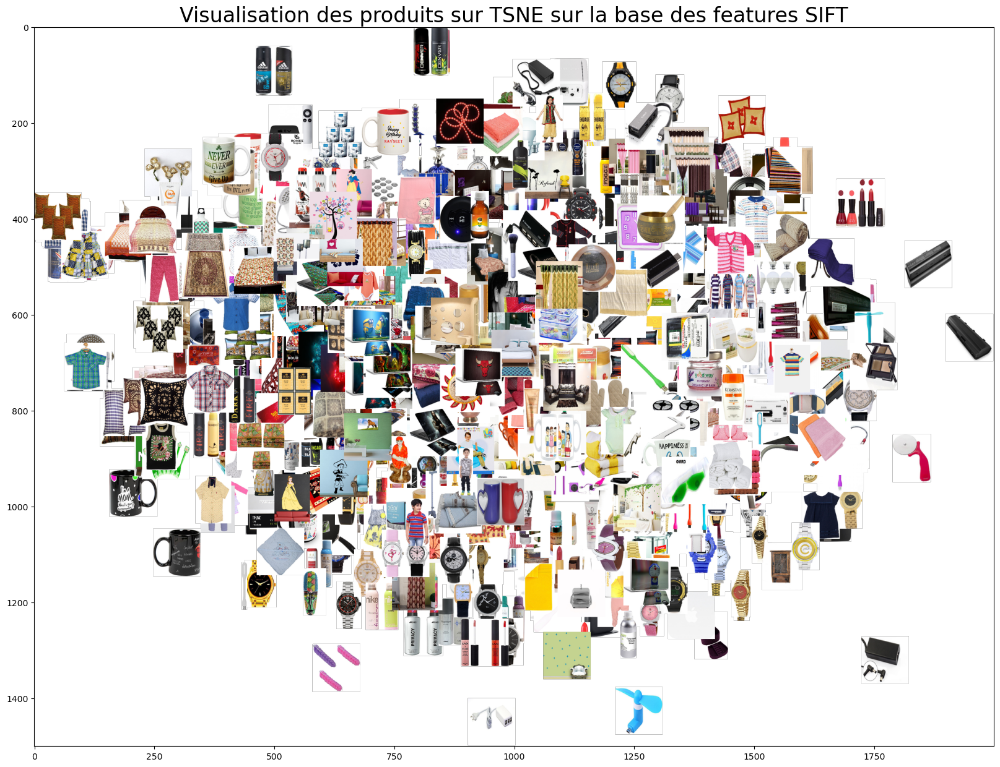

In [81]:
X_tsne=tsne_data(feat_pca)
affiche_images_tsne(X_tsne[:, 0:2], dfmarket['image'])
plt.title('Visualisation des produits sur TSNE sur la base des features SIFT', fontsize=24)
to_png()

-------
Ces résultats ne montrent pas une ***séparation claire*** entre les différentes catégories.    
Nous allons donc essayer aussi avec ***l'approche ORB***. 

#### <font color="#337da4" id="3.2">3.2 ORB (Oriented FAST and Rotated BRIEF) </font>

Cet algorithme combine la détection rapide des keypoints FAST avec les descripteurs binaires BRIEF. Il est efficace et adapté aux applications en temps réel.

### <font color='olive'>Créations des descripteurs de chaque image</font> 

- Pour chaque image passage en gris et equalisation

- création d'une liste de descripteurs par image ("sift_keypoints_by_img") qui sera utilisée pour réaliser les histogrammes par image

- création d'une liste de descripteurs pour l'ensemble des images ("sift_keypoints_all") qui sera utilisée pour créer les clusters de descripteurs

ORB : ORB est fondamentalement une fusion du détecteur de keyspoints FAST et du descripteur BRIEF avec de nombreuses modifications pour améliorer les performances. Il utilise d'abord la FAST pour trouver les points clés, puis applique la mesure des coins de Harris pour trouver les N meilleurs points parmi eux. 

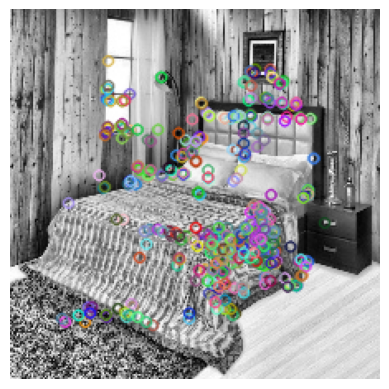

Descripteurs :  (417, 32)
417
[[ 37 197 115 ... 219 198 225]
 [  3 182 106 ...  68 250  86]
 [ 15 171 204 ... 172 120  65]
 ...
 [143 104  14 ...  21  43 146]
 [202 168 142 ...   4  47  74]
 [ 74 147 140 ...   4 153  15]]


In [82]:
#Test sur une image
            
import cv2 as cv
orb = cv.ORB_create()
img = cv.imread(os_path_join(IMG_FOLDER_PROCESS,LIST_PHOTOS[seed]))

# find the keypoints with ORB
kp = orb.detect(img,None)
# compute the descriptors with ORB
kp, des = orb.compute(img, kp)
# draw only keypoints location,not size and orientation
img2 = cv.drawKeypoints(img, kp, None) # , color=(0,255,0), flags=0
plt.imshow(img2)
plt.axis('off')
plt.show()
print("Descripteurs : ", des.shape)
print(len(kp))
print(des)

#### Extraction des features d'une image step by step

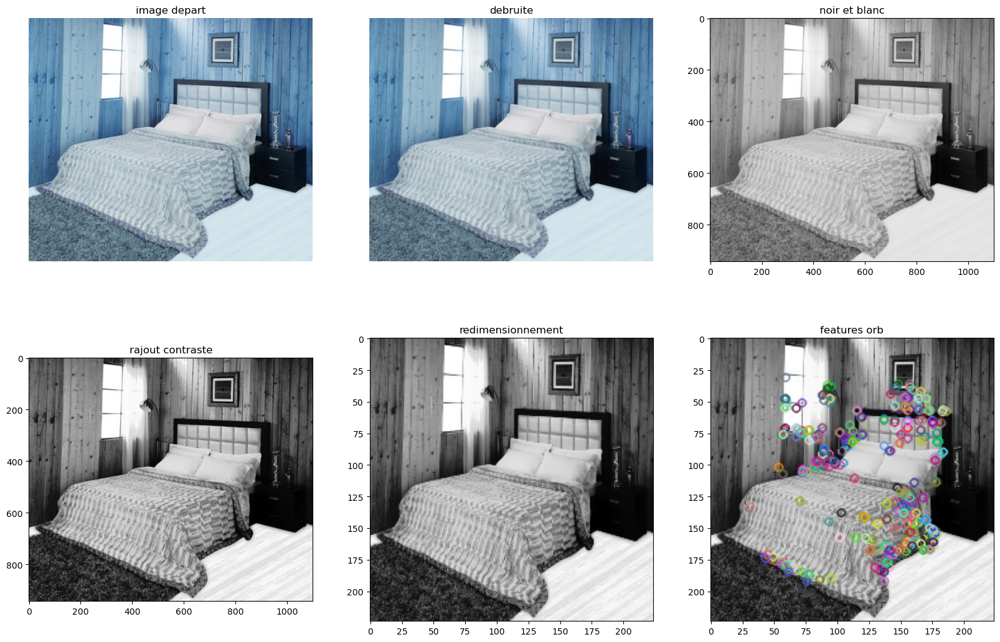

In [83]:
import cv2
import matplotlib.pyplot as plt

orb = cv2.ORB_create()
image = cv2.imread(os_path_join(IMG_FOLDER, LIST_PHOTOS[seed]))

plt.figure(figsize=(20, 13))

plt.subplot(2, 3, 1)
plt.axis('off')
plt.title('image depart')
plt.imshow(image)

# On enleve le bruit
image = cv2.GaussianBlur(image, (5, 5), 0)
plt.subplot(2, 3, 2)
plt.axis('off')
plt.title('debruite')
plt.imshow(image)

# On passe en noir et blanc (grayscale)
gray_img = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
plt.subplot(2, 3, 3)
plt.title('noir et blanc')
plt.imshow(gray_img, cmap='gray')

# Augmentation du contraste par égalisation de l'histogramme
equalized_img = cv2.equalizeHist(gray_img)
plt.subplot(2, 3, 4)
plt.title('rajout contraste')
plt.imshow(equalized_img, cmap='gray')

# On redimensionne pour normaliser l'entrée
dsize = (224, 224)
resized_img = cv2.resize(equalized_img, dsize)
plt.subplot(2, 3, 5)
plt.title('redimensionnement')
plt.imshow(resized_img, cmap='gray')

# Detection des features ORB
kp, des = orb.detectAndCompute(resized_img, None)
img = cv2.drawKeypoints(resized_img, kp, resized_img)
plt.subplot(2, 3, 6)
plt.title('features orb')
plt.imshow(img)

plt.savefig('fig_trait_orb.jpg')
plt.show()


In [84]:
# identification of key points and associated descriptors
import time, cv2

def features_extraction_orb(file_path=IMG_FOLDER, file_name:list=LIST_PHOTOS, n_features=None):
    orb_keypoints = []
    temps1=time.time()
    orb = cv.ORB_create()

    for image_num in range(len(file_name)) :
        if image_num%100 == 0 : print(image_num)
        image =cv2.imread(os_path_join(file_path, file_name[image_num]))

        try:
            kp, des = orb.detectAndCompute(image, None)
            if des is None: 
                des = [np.zeros((32,))]
            orb_keypoints.append(des)
        except:
            print('index :', image_num, 'path :', os_path_join(file_path, file_name[image_num]))
            plt.imshow(image)


    orb_keypoints_by_img = np.asarray(orb_keypoints, dtype=object)
    orb_keypoints_all    = np.concatenate(orb_keypoints_by_img, axis=0)

    print()
    print("Nombre de descripteurs : ", orb_keypoints_all.shape)

    duration1=time.time()-temps1
    print("temps de traitement ORB descriptor : ", "%15.2f" % duration1, "secondes")
    return orb_keypoints_by_img, orb_keypoints_all

orb_keypoints_by_img, orb_keypoints_all=features_extraction_orb(file_path=IMG_FOLDER, 
                                                                file_name=LIST_PHOTOS, 
                                                                n_features=None)

0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (503880, 32)
temps de traitement ORB descriptor :            61.57 secondes


### <font color='olive'>Création des clusters de descripteurs</font> 

Envoyer le dictionnaire visuel à l'algorithme de clustering k-means et trouver les mots visuels qui sont des points centraux.

In [85]:
# Determination number of clusters
temps1=time.time()

#k = 200
k = int(round(np.sqrt(len(orb_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

kmeans = cluster.MiniBatchKMeans(n_clusters=k, random_state=random_state)
kmeans.fit(orb_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  710
Création de 710 clusters de descripteurs ...
temps de traitement kmeans :             4.53 secondes


### <font color='olive'>Création des features des images</font> 

Features d'une image = Histogramme d'une image = Comptage pour une image du nombre de descripteurs par cluster

* Pour chaque image : 
   - prédiction des numéros de cluster de chaque descripteur
   - création d'un histogramme = comptage pour chaque numéro de cluster du nombre de descripteurs de l'image

In [86]:
### Histogramme pour chaque features

temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(orb_keypoints_by_img) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :            25.32 secondes


#### Réduction PCA

In [87]:
pca = PCA(n_components=0.95, random_state=random_state)
pca.fit_transform(im_features)

array([[ 0.00294294, -0.02915164, -0.0040232 , ..., -0.00200503,
         0.00033185,  0.00019467],
       [ 0.00141291, -0.02349058, -0.0019152 , ...,  0.00026423,
        -0.00348622,  0.00129491],
       [-0.00572476,  0.03387112, -0.00037035, ..., -0.00106257,
         0.00173052, -0.00211572],
       ...,
       [-0.00255929, -0.00846318, -0.00153745, ..., -0.00179024,
         0.00075975, -0.00094799],
       [-0.00221544, -0.00986566, -0.00093771, ...,  0.00274553,
        -0.00158582, -0.00016059],
       [-0.00530975,  0.03157436, -0.00545055, ..., -0.00292144,
        -0.00207076, -0.00500232]])

In [88]:
def inertia(pca):
    """
    Graph representing the eigenvalues of the pca model based on the file
    under study
    pca : pca of the model"""
    scree = pca.explained_variance_ratio_ * 100
    plt.bar(np.arange(len(scree)) + 1, scree)
    plt.plot(np.arange(len(scree)) + 1, scree.cumsum(), c="red", marker="o")
    plt.xlabel("rank of the axis of inertia")
    plt.ylabel("percentage of inertia")
    plt.title("Eigenvalue decay")  # Eboulis des valeurs propres
    plt.show(block=False)

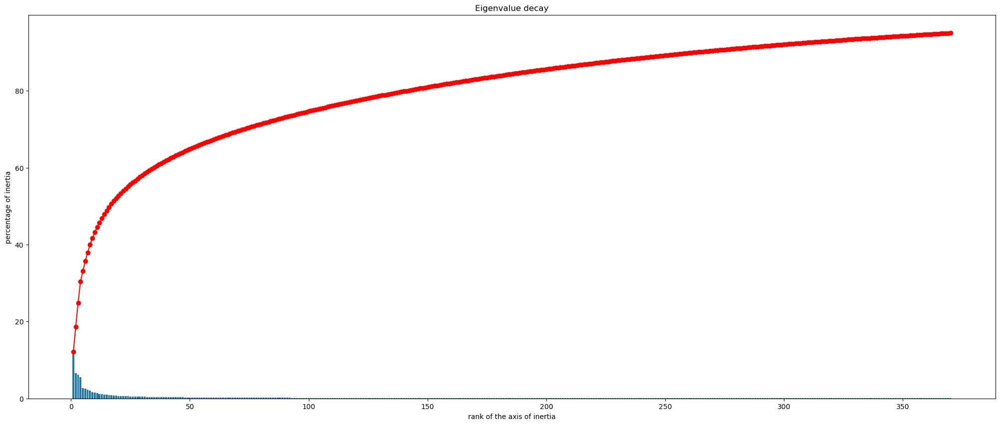

In [89]:
plt.figure(figsize=(25, 10))
inertia(pca)

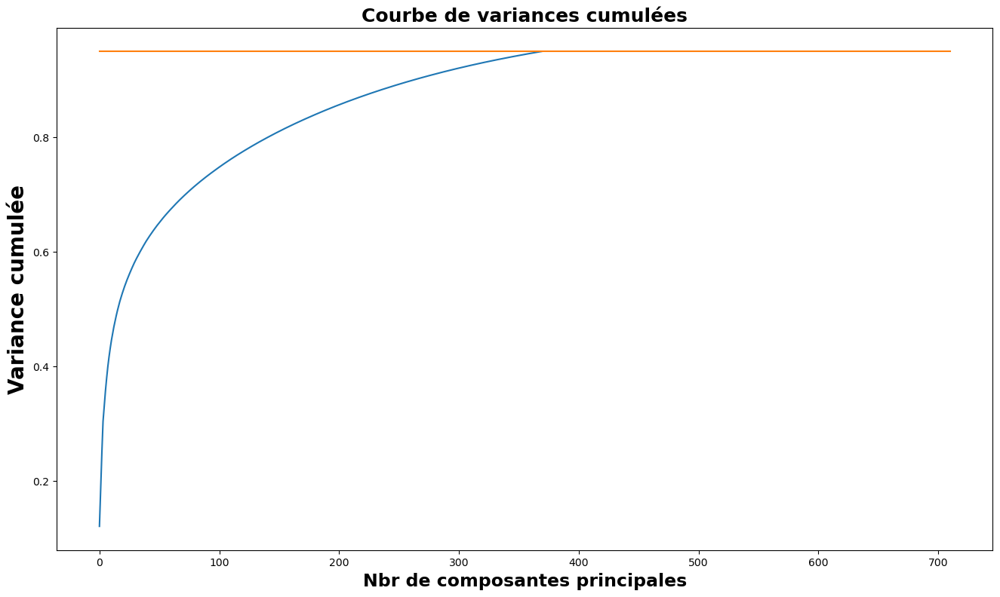

In [90]:
df_visual_word_total = pd.DataFrame(im_features)

plt.figure(figsize=(16, 9))
plt.ylabel("Variance cumulée", weight='bold', size=20)
plt.xlabel('Nbr de composantes principales', weight='bold', size=17)
plt.plot(pca.explained_variance_ratio_.cumsum())
plt.title('Courbe de variances cumulées', size=18, weight='bold')
plt.plot([0, df_visual_word_total.shape[1]], [0.95, 0.95])

In [91]:
c = 0
for i in pca.explained_variance_ratio_.cumsum():
    c += 1
    if(i > 0.99):
        print(
            'Il faut {} composantes pour expliquer 99% de la variance du dataset'.format(c))
        break
        

Shape avant réduction :  (1050, 710)

Shape après réduction : (1050, 596)
Il faut 596 composantes pour expliquer 99% de la variance du dataset.



<Axes: title={'center': "Plan factoriel pour les composantes 1 et 2 de l'ACP"}, xlabel='Component 1', ylabel='Component 2'>

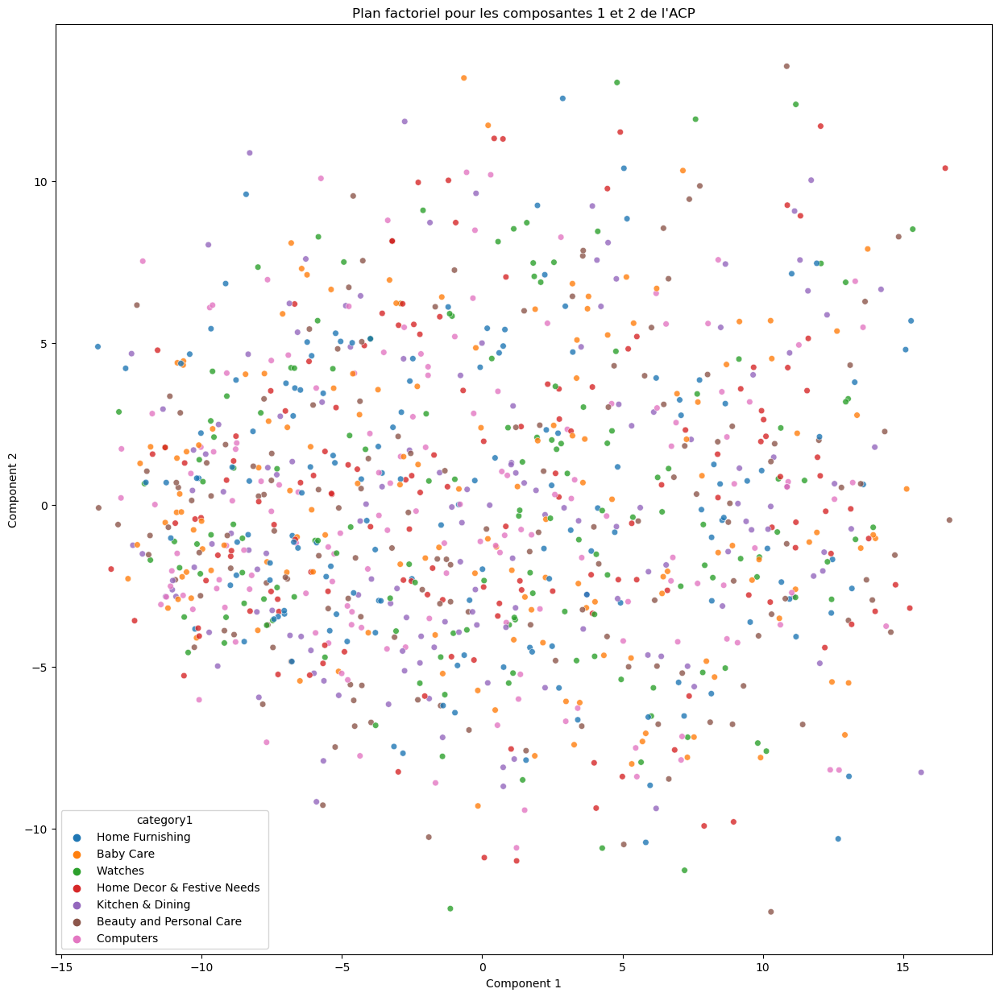

In [92]:
composantes = pca.components_
nbre_composantes = pca.n_components

X_pca, c = pca_data(im_features, n_comp=0.99)
a_show = X_pca[:, 0]  # Component 1
b_show = X_pca[:, 1]  # Component 2


# sns.set_context("paper", font_scale=1.5)
plt.figure(figsize=(15, 15))
chaine = "Plan factoriel pour les composantes 1 et 2 de l'ACP"
plt.title(chaine)
plt.xlabel("Component 1")
plt.ylabel("Component 2")
ax = plt.gca()

sns.scatterplot(
    x=a_show,
    y=b_show,
    hue=dfmarket['category1'],
    alpha=0.8,
    s=30
)
# sns.set_context("paper", font_scale=1)

Shape avant réduction :  (1050, 710)

Shape après réduction : (1050, 596)
Il faut 596 composantes pour expliquer 99% de la variance du dataset.

************************************************************************************************************************
Reduction : PCA, ARI :  0.0023, time : 1.0
************************************************************************************************************************



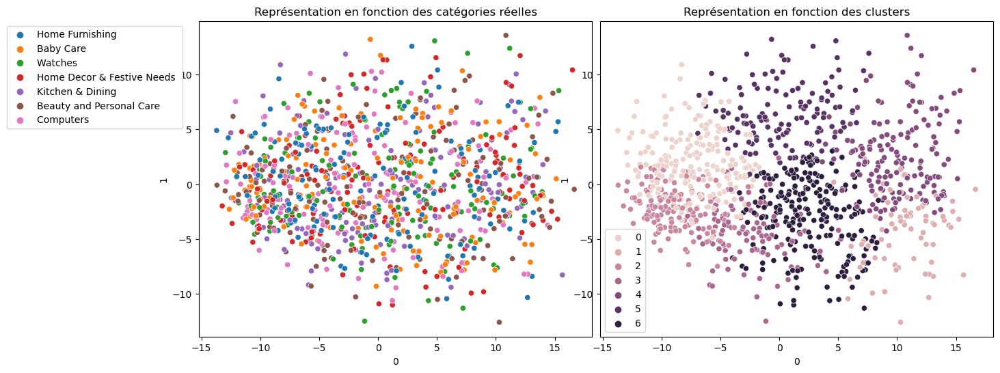

In [93]:
y_true=dfmarket['category1']
feat_pca, c = pca_data(im_features, scaler=StandardScaler(), n_comp=0.99)
y_pred, ARI=visu_categories(feat_pca, y_true, reduction='PCA', figsize=(15, 6))



### Réduction TSNE

************************************************************************************************************************
Reduction : TSNE, ARI :  -0.0017, time : 6.0
************************************************************************************************************************



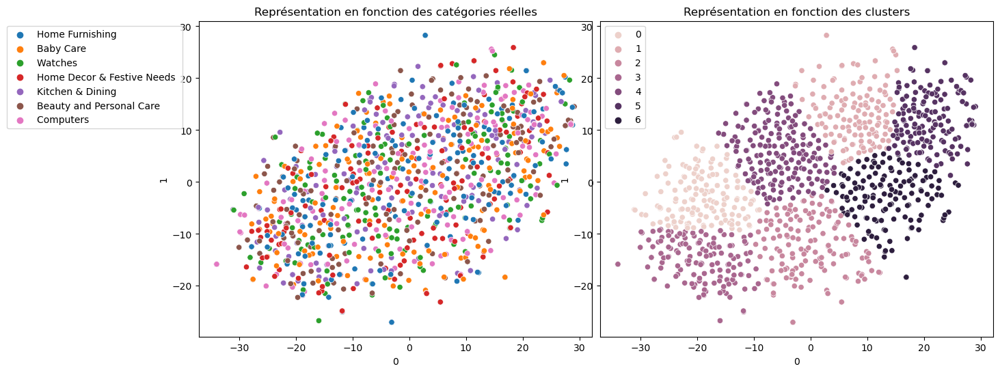

In [94]:
y_pred, ARI=visu_categories(feat_pca, y_true, reduction='TSNE', figsize=(15, 6))

[[29  8 20 13 22 24 34]
 [27 17 22 19 24 15 26]
 [28  7 27 13 21 22 32]
 [24 13 20 12 27 28 26]
 [46 13 12 15 21 16 27]
 [27  6 17 21 28 15 36]
 [26 10 17 10 21 24 42]]
**************************************************
Correspondance calculée : [4 1 2 5 5 3 6]
Correspondance          : [4, 1, 2, 5, 0, 3, 6]

**************************************************
[[22  8 20 24 29 13 34]
 [24 17 22 15 27 19 26]
 [21  7 27 22 28 13 32]
 [27 13 20 28 24 12 26]
 [21 13 12 16 46 15 27]
 [28  6 17 15 27 21 36]
 [21 10 17 24 26 10 42]]
**************************************************
Métriques de performance par classe:.
**************************************************

              precision    recall  f1-score   support

           0       0.13      0.15      0.14       150
           1       0.23      0.11      0.15       150
           2       0.20      0.18      0.19       150
           3       0.19      0.19      0.19       150
           4       0.22      0.31      0.26       150
   

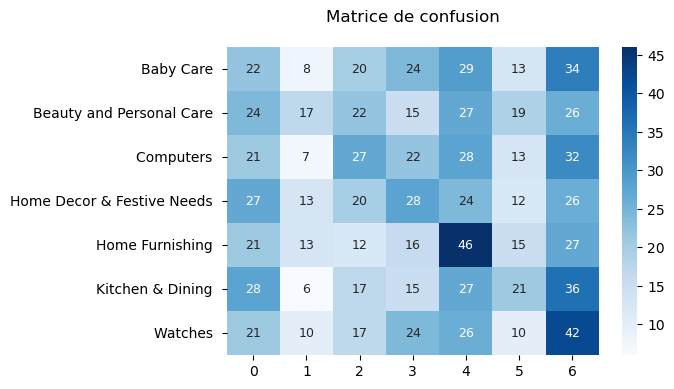

In [95]:
corresp=[4, 1, 2, 5, 0, 3, 6]
matrice_confusion(dfmarket,'category1',"cat_code", feat_pca, corresp=corresp)
to_png(fig_name='confusion_ORB')

reducer t-SNE, input shape=(1050, 596)
reducer t-SNE, shape =(1050, 2) time : 11.0
"Visualisation_des_produits_sur_TSNE_sur_la_base_des_features_ORB.png"


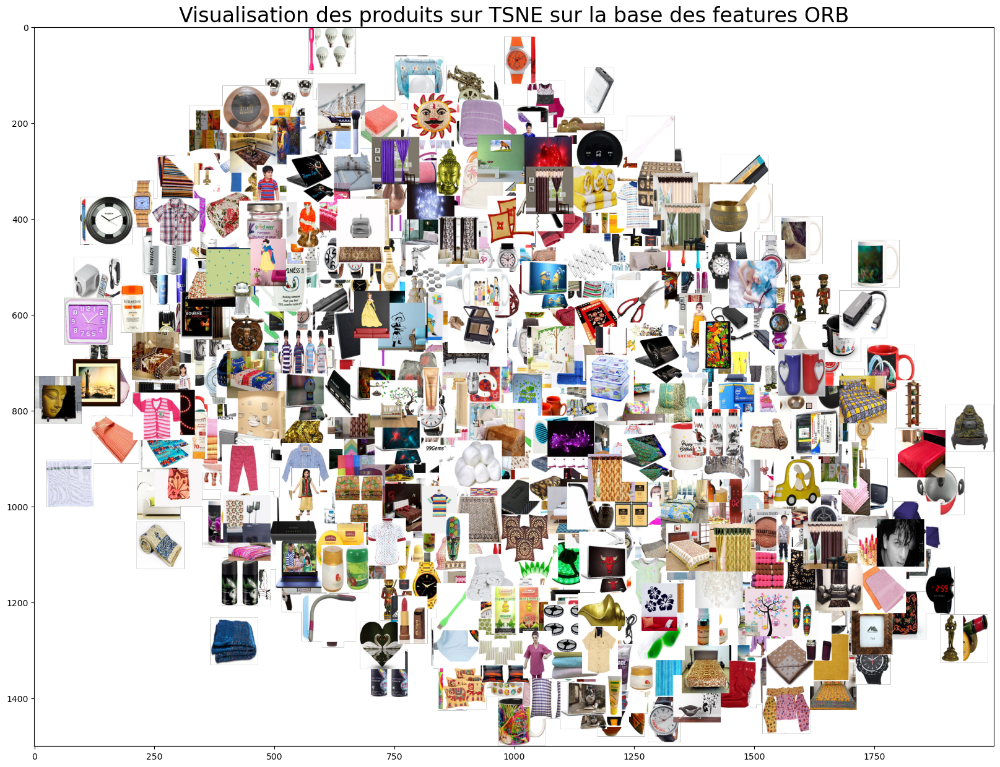

In [96]:
X_tsne=tsne_data(feat_pca)
affiche_images_tsne(X_tsne[:, 0:2], dfmarket['image'])
plt.title('Visualisation des produits sur TSNE sur la base des features ORB', fontsize=24)
to_png()

---------
- Comme constaté avec la méthode SIFT, ***la méthode ORB*** ne permet pas une bonne separation des clusters
- Le score ARI est très faible
- Le graphique ne montre pas une ***distinction nette des catégories de produits***.

#### <font color="#337da4" id="3.3">3.3 SURF (Speeded Up Robust Features) </font>

Inspiré par SIFT, ***SURF*** est un algorithme de détection de keypoints et d'extraction de descripteurs qui est plus rapide tout en étant également robuste aux transformations d'échelle, de rotation et de changements d'illumination.

***Cette méthode ne sera plus appliquée dans le cadre de ce projet.*** 

In [97]:
!pip list>requirements_cp.txt